In [1]:
import os
os.chdir('../')
import uuid
from pathlib import Path
import numpy as np
import json
import h5py
from math import floor, ceil
from matplotlib import pyplot as plt
from glob import glob

In [2]:
def check(filename, subset):
    files = []
    for k, v in subset.items():
        for f, _ in v:
            files.append(f)
    if filename in files:
        print('OLD')
    else:
        print('NEW')
        
def check_existence(subset, json_data):
    all_exist = True
    # Check if picked files are contained in the eval dataset
    for k,v in subset.items():
        for f in v:
            if f in json_data['files']:
                pass
            else:
                print(f'{f} not in eval dataset')
                all_exist = False
    return all_exist

def random_slice(subset, json_data, low_percent=0.15, high_percent=0.85, seed=0):
    rng = np.random.RandomState(seed)
    # Check if picked files are contained in the eval dataset
    for k, files in subset.items():
        slices = []
        for f in files:
            path = json_data['files'][f]['path']
            with h5py.File(path, 'r') as hf:
                num_slices = len(hf['kspace'])
            slice = rng.randint(low=floor(low_percent*num_slices), high=ceil(high_percent*num_slices), size=1)[0]
            slices.append(slice)
        subset[k] = list(zip(files, slices))

def plot_subset(subset, json_data):
    for k, v in subset.items():
        for f, s in v:
            path = json_data['files'][f]['path']
            with h5py.File(path, 'r') as hf:
                target = hf['reconstruction_rss'][s]
                maxval = hf.attrs['max']
            print(f"File: {f}, Type: {k}, Slice: {s}")
            plt.imshow(target, cmap='gray', vmax=maxval/1.6)
            plt.axis('off')
            plt.show()

def save_subset(subset, json_data):
    slice_subset = {
        "dataset_name": json_data['dataset_name'] + '_curated',
        "uuid": str(uuid.uuid4()),
        "num_slices": 0,
        "files": {}
    }
    num_slices = 0
    for _, v in subset.items():
        for f, s in v:
            s = str(s)
            num_slices += 1
            if f not in slice_subset['files']:
                slice_subset['files'][f] = json_data['files'][f].copy()
                slice_subset['files'][f]['slices'] = {}
            slice_subset['files'][f]['slices'][s] = json_data['files'][f]['slices'][s]
    slice_subset['num_slices'] = num_slices
    
    data_json = json.dumps(slice_subset, indent=4)

    with open(os.path.join('datasets/evals/classic', slice_subset['dataset_name'] + '.json'), 'w') as outfile:
        outfile.write(data_json)

def save_nuanced_subset(subset, json_data):
    for k, v in subset.items():
        slice_subset = {
            "dataset_name": json_data['dataset_name'] + '_curated_' + k,
            "uuid": str(uuid.uuid4()),
            "num_slices": 0,
            "files": {}
        }
        num_slices = 0

        for f, s in v:
            s = str(s)
            num_slices += 1
            if f not in slice_subset['files']:
                slice_subset['files'][f] = json_data['files'][f].copy()
                slice_subset['files'][f]['slices'] = {}
            slice_subset['files'][f]['slices'][s] = json_data['files'][f]['slices'][s]
        slice_subset['num_slices'] = num_slices
        
        data_json = json.dumps(slice_subset, indent=4)

        with open(os.path.join('datasets/evals/classic/nuanced_new', slice_subset['dataset_name'] + '.json'), 'w') as outfile:
            outfile.write(data_json)
                

File: file1001955.h5, Type: pdfs_30t, Slice: 6


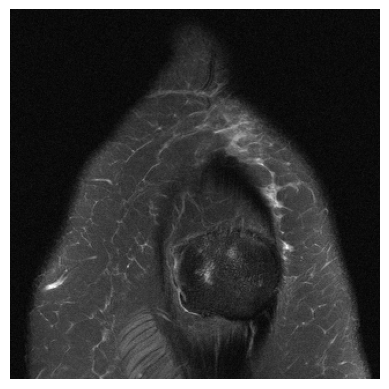

File: file1000942.h5, Type: pdfs_30t, Slice: 14


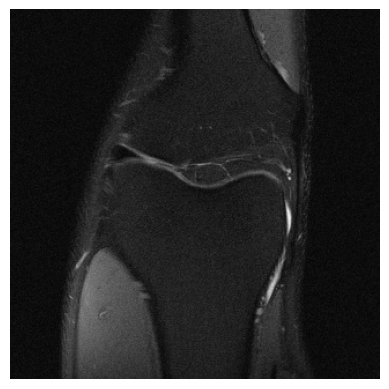

File: file1000858.h5, Type: pdfs_30t, Slice: 19


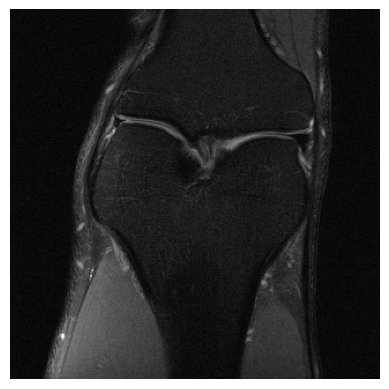

File: file1000899.h5, Type: pdfs_30t, Slice: 24


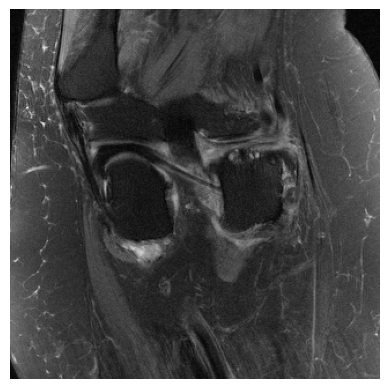

File: file1001144.h5, Type: pdfs_30t, Slice: 33


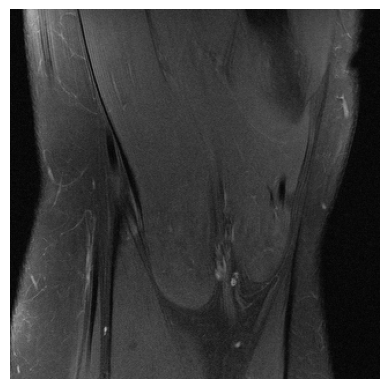

File: file1000389.h5, Type: pd_30t, Slice: 8


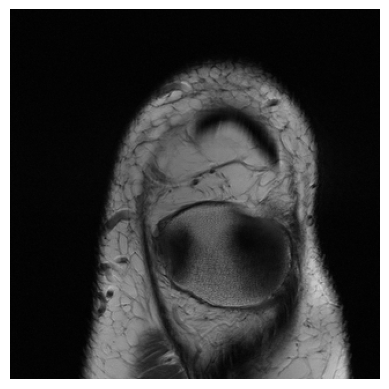

File: file1001930.h5, Type: pd_30t, Slice: 14


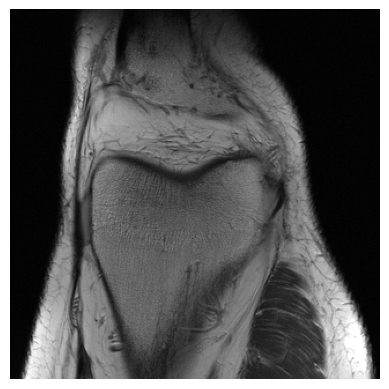

File: file1001497.h5, Type: pd_30t, Slice: 21


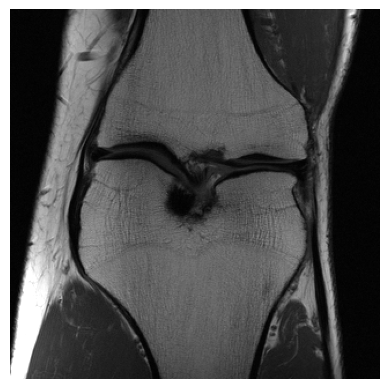

File: file1000041.h5, Type: pd_30t, Slice: 27


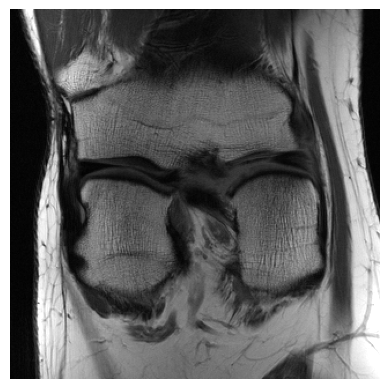

File: file1001458.h5, Type: pd_30t, Slice: 34


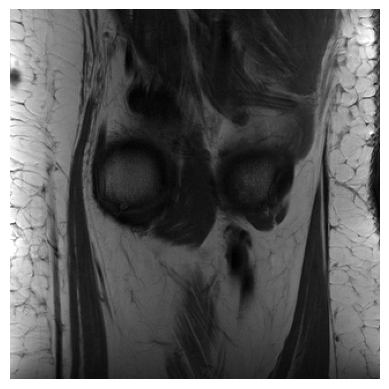

File: file1000555.h5, Type: pdfs_15t, Slice: 5


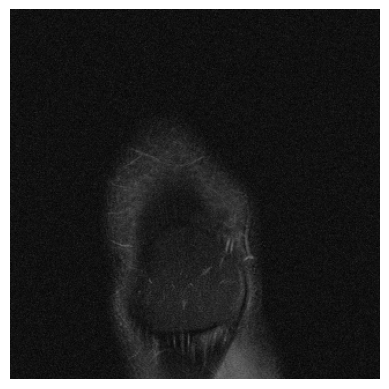

File: file1000247.h5, Type: pdfs_15t, Slice: 13


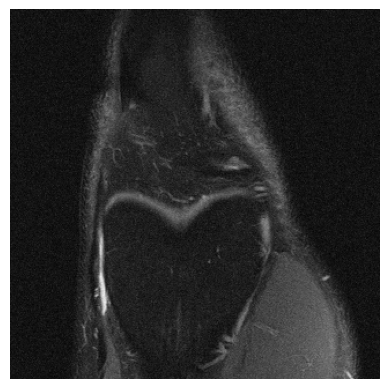

File: file1000206.h5, Type: pdfs_15t, Slice: 18


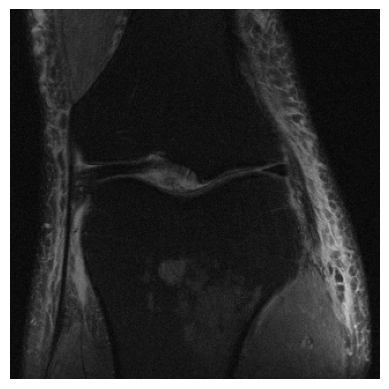

File: file1000114.h5, Type: pdfs_15t, Slice: 26


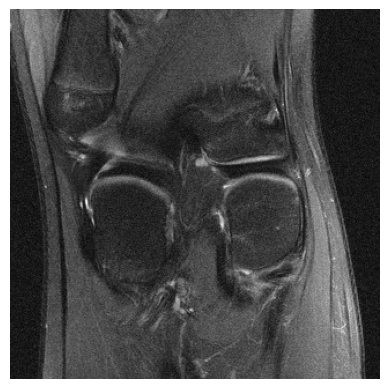

File: file1002538.h5, Type: pdfs_15t, Slice: 31


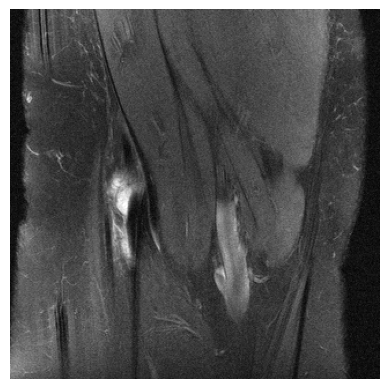

File: file1000052.h5, Type: pd_15t, Slice: 6


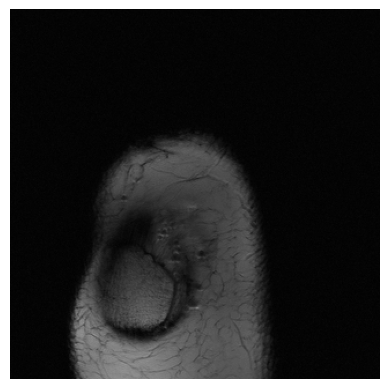

File: file1001995.h5, Type: pd_15t, Slice: 10


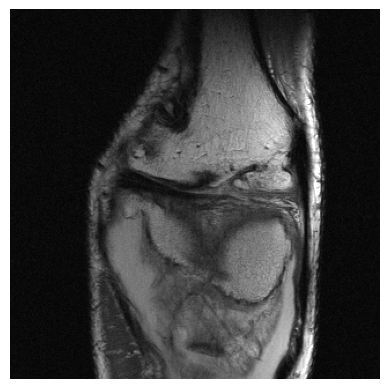

File: file1000107.h5, Type: pd_15t, Slice: 17


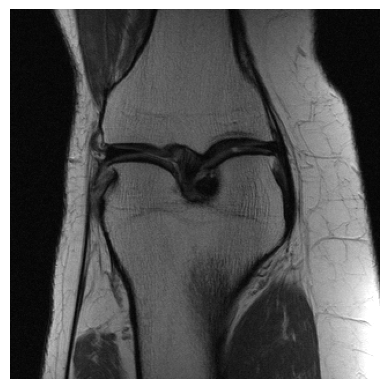

File: file1000885.h5, Type: pd_15t, Slice: 22


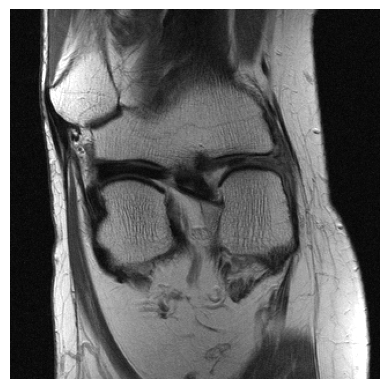

File: file1000153.h5, Type: pd_15t, Slice: 28


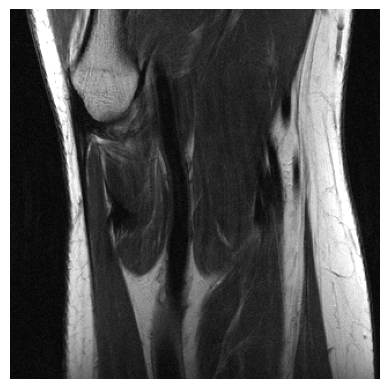

In [3]:
# fastMRI knee: Total 20 Slices
# 5 x PD 1.5T, 5 x PD 3.0T, 5 x PDFS 1.5T, 5 x PDFS 3.0T

subset = {}
# PDFS, 3T:
subset['pdfs_30t'] = [('file1001955.h5', 6), ('file1000942.h5', 14), ('file1000858.h5', 19), ('file1000899.h5', 24), ('file1001144.h5', 33)]
# PD, 3T:
subset['pd_30t'] = [('file1000389.h5', 8), ('file1001930.h5', 14), ('file1001497.h5', 21), ('file1000041.h5', 27), ('file1001458.h5', 34)]
# PDFS, 1.5T:
subset['pdfs_15t'] = [('file1000555.h5', 5), ('file1000247.h5', 13), ('file1000206.h5', 18), ('file1000114.h5', 26), ('file1002538.h5', 31)]
# PD, 1.5T:2
subset['pd_15t'] = [('file1000052.h5', 6), ('file1001995.h5', 10), ('file1000107.h5', 17), ('file1000885.h5', 22), ('file1000153.h5', 28)]

path_to_json = 'datasets/evals/classic/fastmri_knee.json'
with open(path_to_json) as f:
    json_data = json.load(f)

# print('All files in eval dataset:', check_existence(subset, json_data))

plot_subset(subset, json_data)

# save_nuanced_subset(subset, json_data)


File: file_brain_AXT2_208_2080376.h5, Type: t2_15t_4c, Slice: 1


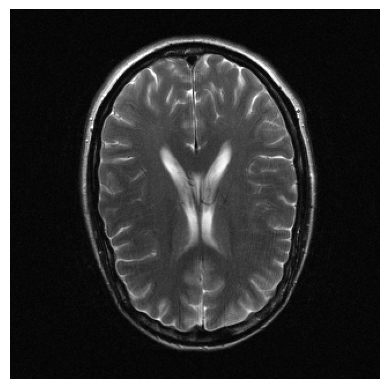

File: file_brain_AXT2_207_2070369.h5, Type: t2_15t_4c, Slice: 3


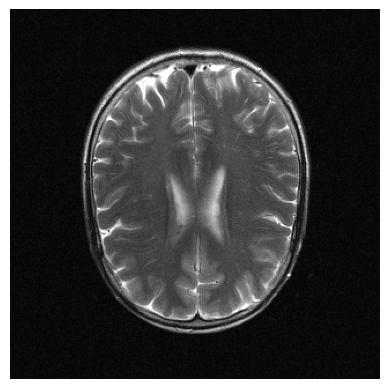

File: file_brain_AXT2_208_2080015.h5, Type: t2_15t_4c, Slice: 5


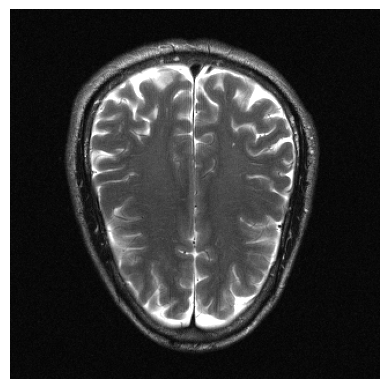

File: file_brain_AXT2_207_2070413.h5, Type: t2_15t_4c, Slice: 8


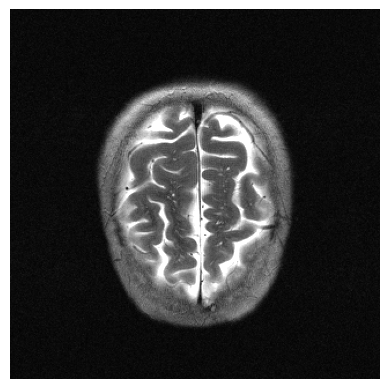

File: file_brain_AXT2_207_2070710.h5, Type: t2_15t_4c, Slice: 11


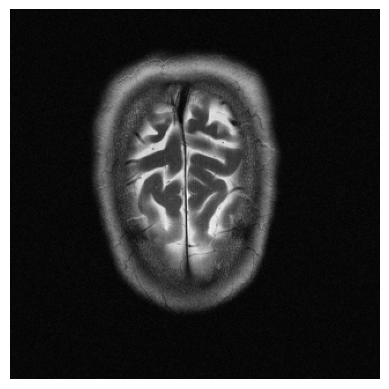

File: file_brain_AXT1POST_208_2080017.h5, Type: t1post_15t_4c, Slice: 1


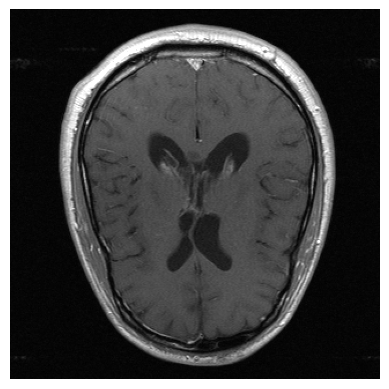

File: file_brain_AXT1POST_207_2070682.h5, Type: t1post_15t_4c, Slice: 3


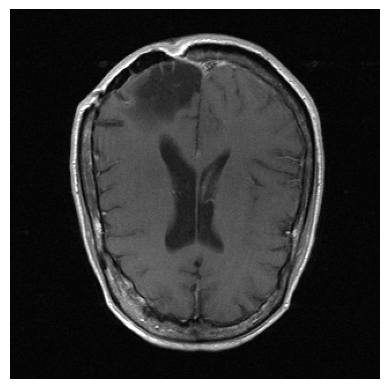

File: file_brain_AXT1POST_207_2070741.h5, Type: t1post_15t_4c, Slice: 5


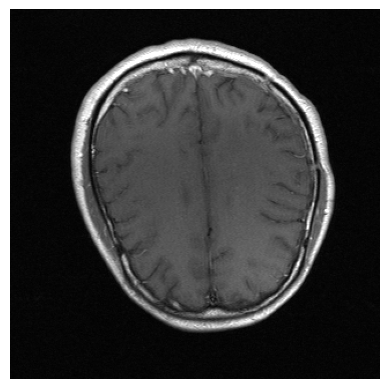

File: file_brain_AXT1POST_207_2070203.h5, Type: t1post_15t_4c, Slice: 8


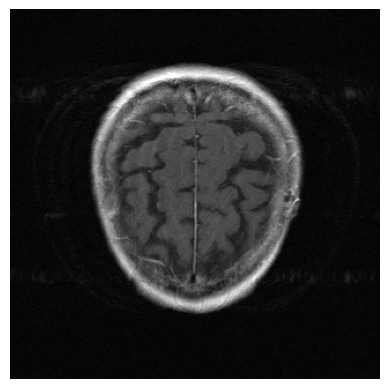

File: file_brain_AXT1POST_207_2070455.h5, Type: t1post_15t_4c, Slice: 11


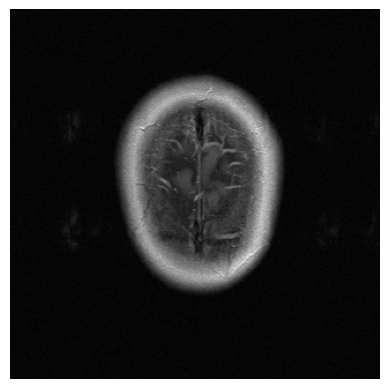

File: file_brain_AXT2_202_2020425.h5, Type: t2_15t_16c, Slice: 1


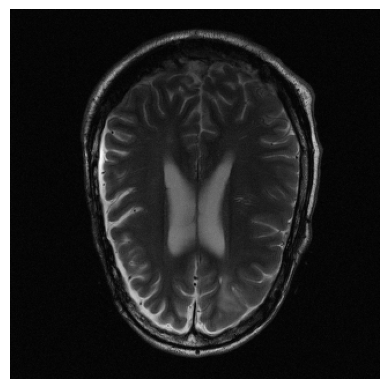

File: file_brain_AXT2_206_2060069.h5, Type: t2_15t_16c, Slice: 3


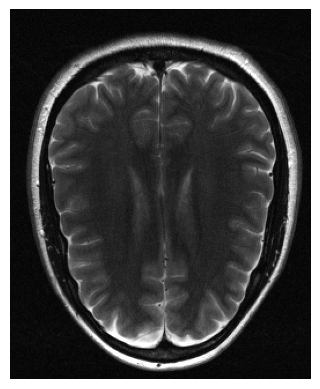

File: file_brain_AXT2_202_2020536.h5, Type: t2_15t_16c, Slice: 5


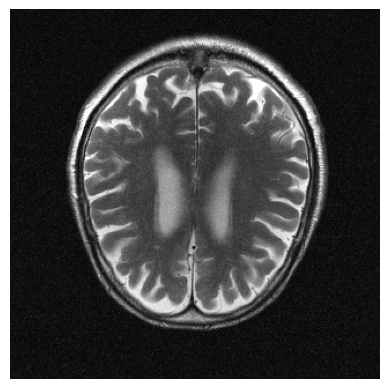

File: file_brain_AXT2_202_2020339.h5, Type: t2_15t_16c, Slice: 8


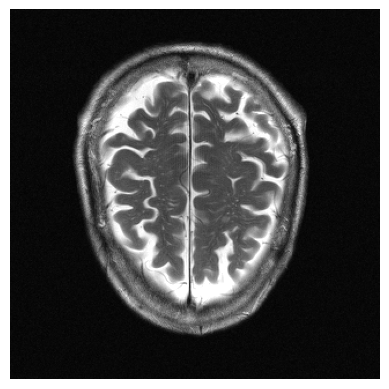

File: file_brain_AXT2_205_2050198.h5, Type: t2_15t_16c, Slice: 11


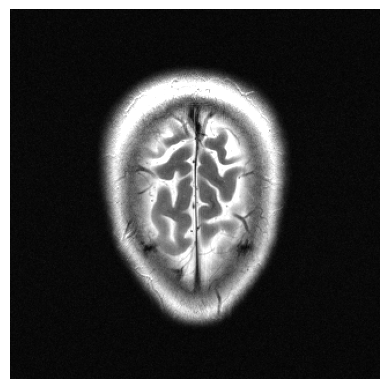

File: file_brain_AXT1POST_205_2050123.h5, Type: t1post_15t_20c, Slice: 1


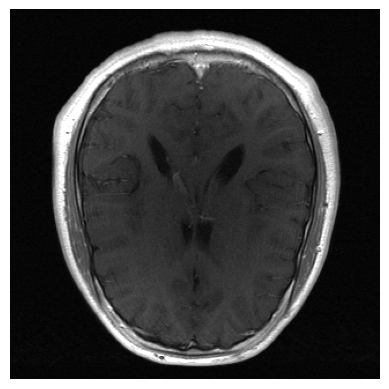

File: file_brain_AXT1POST_205_2050202.h5, Type: t1post_15t_20c, Slice: 3


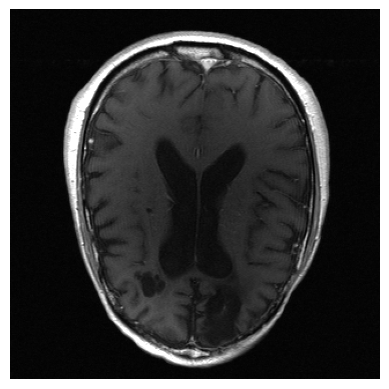

File: file_brain_AXT1POST_205_6000098.h5, Type: t1post_15t_20c, Slice: 5


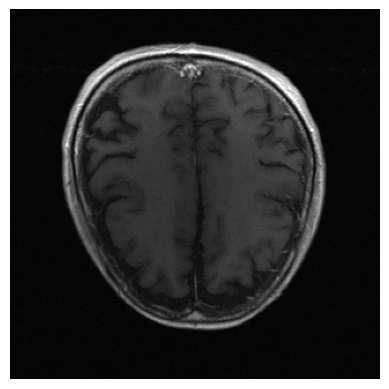

File: file_brain_AXT1POST_205_2050202.h5, Type: t1post_15t_20c, Slice: 8


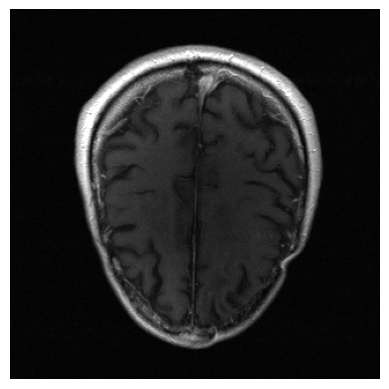

File: file_brain_AXT1POST_205_6000098.h5, Type: t1post_15t_20c, Slice: 11


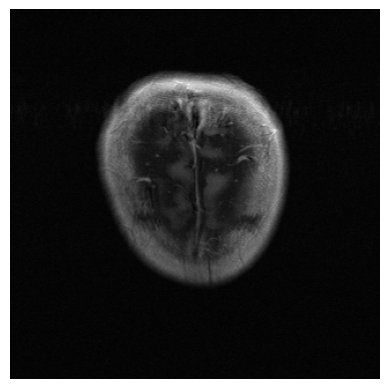

File: file_brain_AXT1_202_6000368.h5, Type: t1_15t_16-20c, Slice: 1


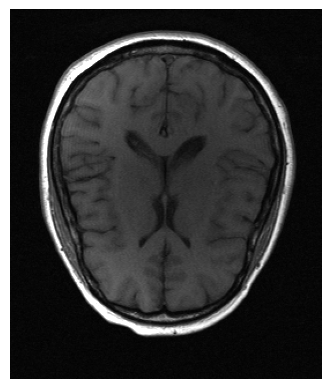

File: file_brain_AXT1_202_6000301.h5, Type: t1_15t_16-20c, Slice: 3


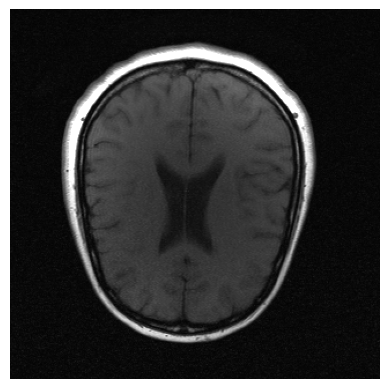

File: file_brain_AXT1_202_2020202.h5, Type: t1_15t_16-20c, Slice: 5


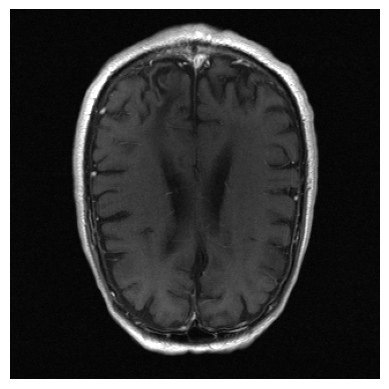

File: file_brain_AXT1_202_2020557.h5, Type: t1_15t_16-20c, Slice: 8


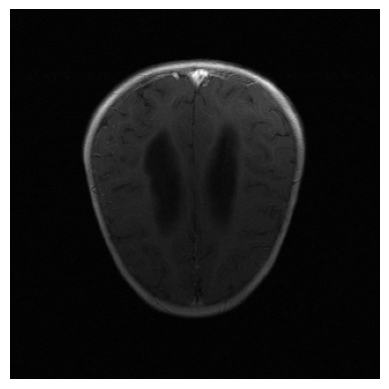

File: file_brain_AXT1_206_2120004.h5, Type: t1_15t_16-20c, Slice: 11


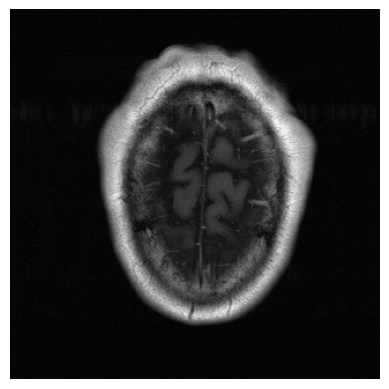

File: file_brain_AXFLAIR_202_6000415.h5, Type: flair_15t_16-20c, Slice: 1


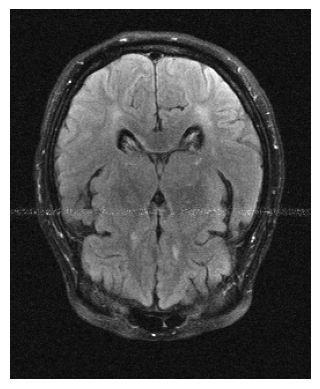

File: file_brain_AXFLAIR_202_6000560.h5, Type: flair_15t_16-20c, Slice: 3


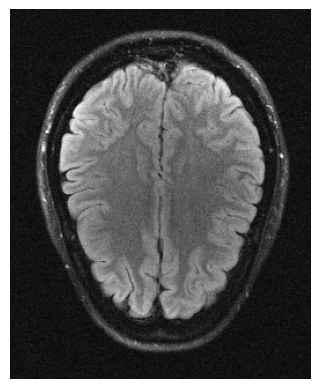

File: file_brain_AXFLAIR_202_6000552.h5, Type: flair_15t_16-20c, Slice: 5


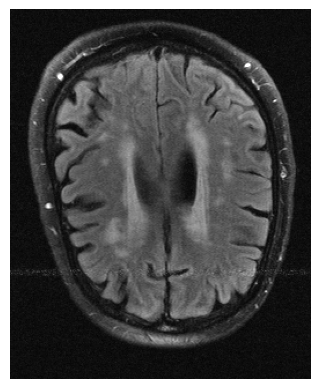

File: file_brain_AXFLAIR_202_6000560.h5, Type: flair_15t_16-20c, Slice: 8


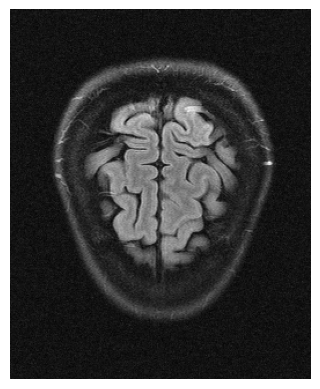

File: file_brain_AXFLAIR_202_6000552.h5, Type: flair_15t_16-20c, Slice: 11


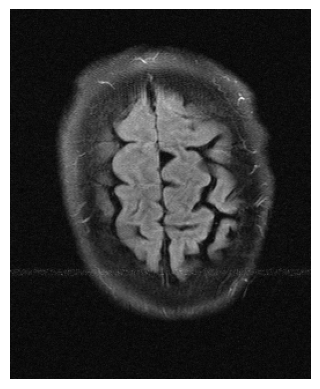

File: file_brain_AXT2_200_6002137.h5, Type: t2_30t_16c, Slice: 1


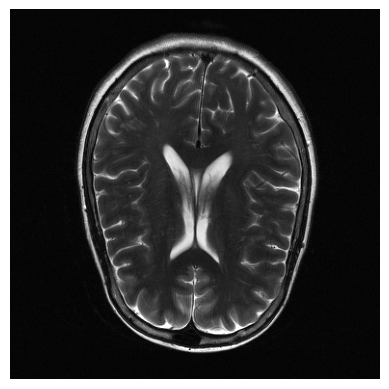

File: file_brain_AXT2_210_2100389.h5, Type: t2_30t_16c, Slice: 3


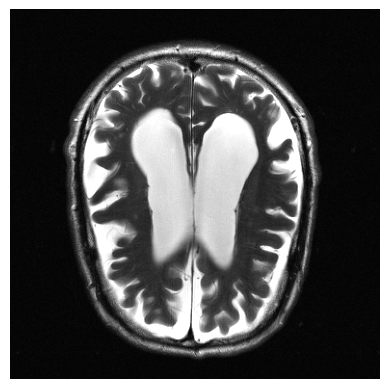

File: file_brain_AXT2_200_6002400.h5, Type: t2_30t_16c, Slice: 5


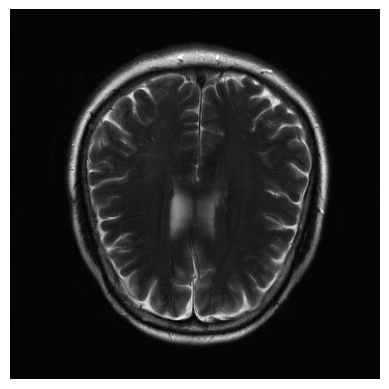

File: file_brain_AXT2_201_2010178.h5, Type: t2_30t_16c, Slice: 8


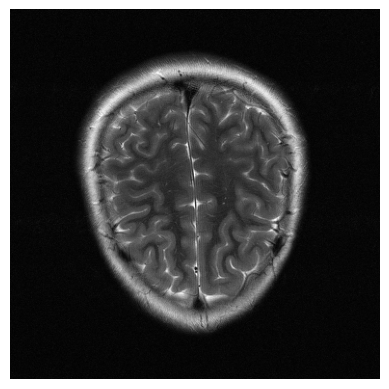

File: file_brain_AXT2_201_2010190.h5, Type: t2_30t_16c, Slice: 11


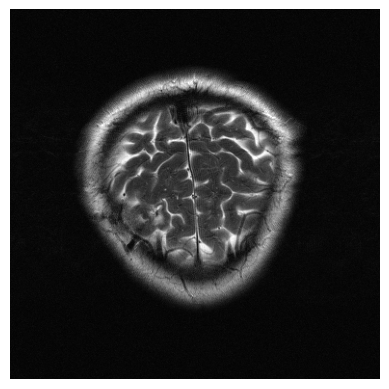

File: file_brain_AXT1POST_210_6001565.h5, Type: t1post_30t_16c, Slice: 1


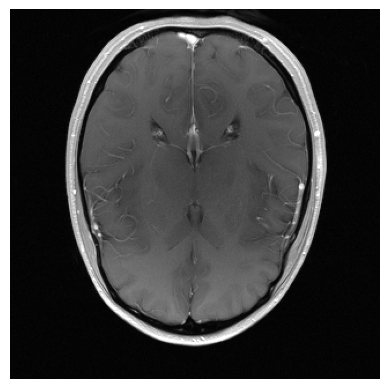

File: file_brain_AXT1POST_210_6001832.h5, Type: t1post_30t_16c, Slice: 3


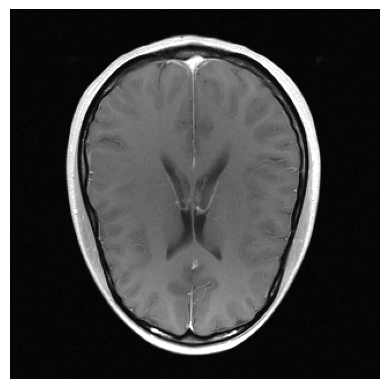

File: file_brain_AXT1POST_210_6001623.h5, Type: t1post_30t_16c, Slice: 5


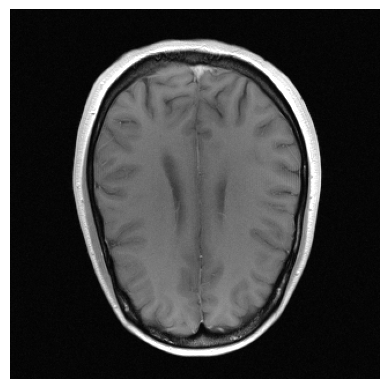

File: file_brain_AXT1POST_200_6002360.h5, Type: t1post_30t_16c, Slice: 8


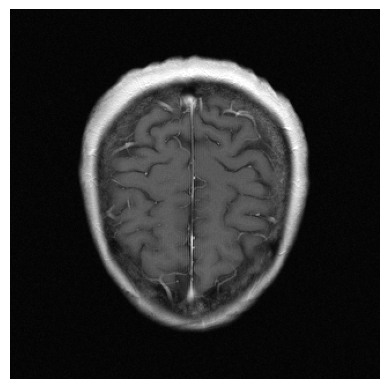

File: file_brain_AXT1POST_200_6002126.h5, Type: t1post_30t_16c, Slice: 11


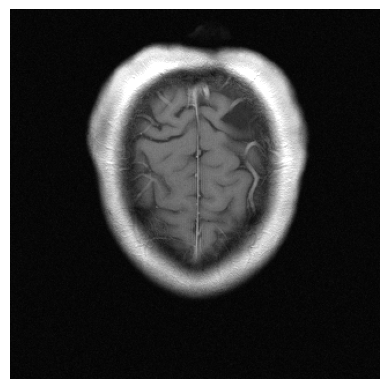

File: file_brain_AXT1PRE_210_6001861.h5, Type: t1_30t_16c, Slice: 1


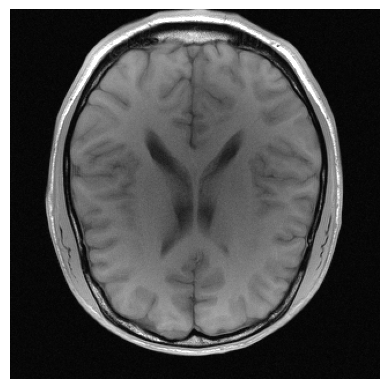

File: file_brain_AXT1PRE_200_6002215.h5, Type: t1_30t_16c, Slice: 3


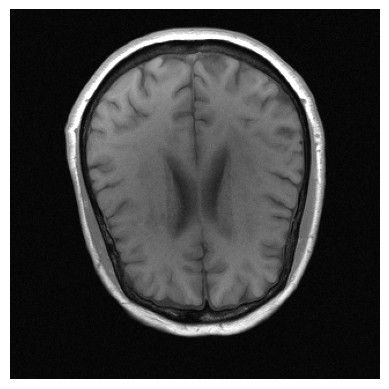

File: file_brain_AXT1PRE_210_6001766.h5, Type: t1_30t_16c, Slice: 5


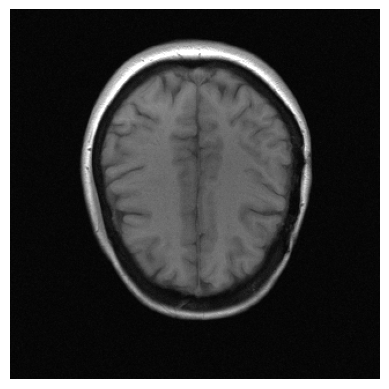

File: file_brain_AXT1PRE_210_6001713.h5, Type: t1_30t_16c, Slice: 8


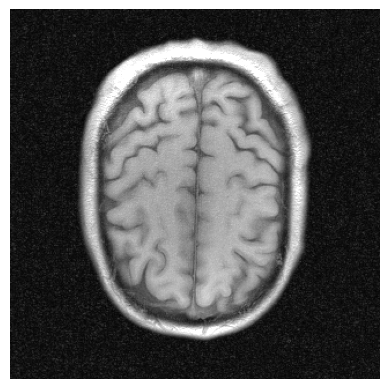

File: file_brain_AXT1PRE_200_6002385.h5, Type: t1_30t_16c, Slice: 11


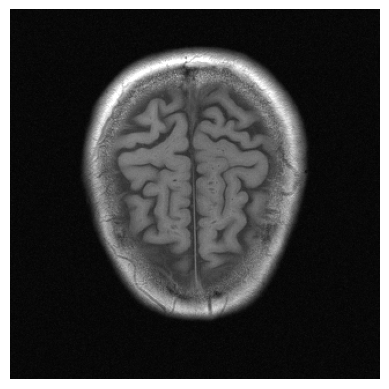

File: file_brain_AXFLAIR_200_6002621.h5, Type: flair_30t_16c, Slice: 1


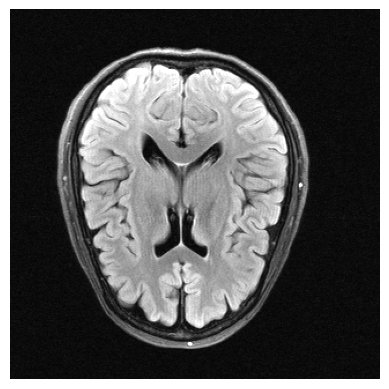

File: file_brain_AXFLAIR_200_6002497.h5, Type: flair_30t_16c, Slice: 3


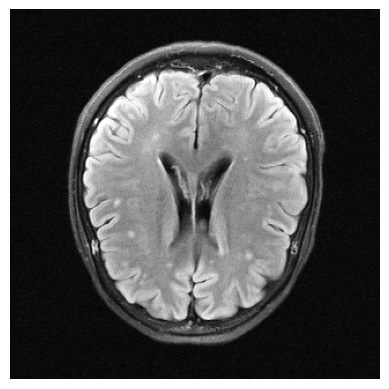

File: file_brain_AXFLAIR_201_6002891.h5, Type: flair_30t_16c, Slice: 5


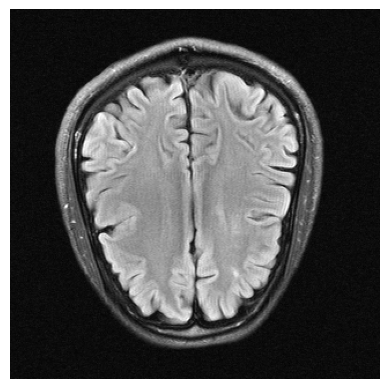

File: file_brain_AXFLAIR_200_6002527.h5, Type: flair_30t_16c, Slice: 8


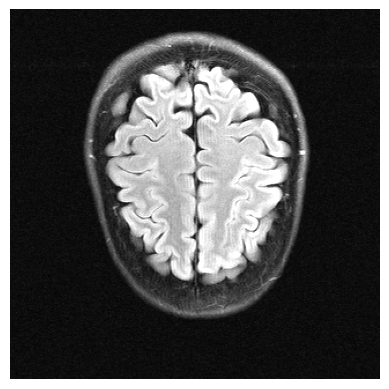

File: file_brain_AXFLAIR_210_6001523.h5, Type: flair_30t_16c, Slice: 11


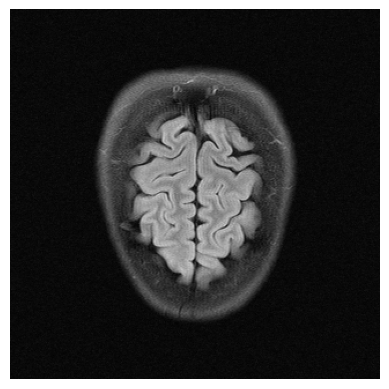

In [4]:
# fastMRI brain: Total 50 Slices
# 5 x T2 1.5T 4 coils, 5 x T1POST 1.5T 4 coils,
# 5 x T2 1.5T 16 coils, 5 x T1POST 1.5T 20 coils, 5 x T1 1.5T 16 coils, 5 x FLAIR 1.5T 16-20 coils,
# 5 x T2 3.0T 16 coils, 5 x T1POST 3.0T 16 coils,  5 x T1 3.0T 16 coils, 5 x FLAIR 3.0T 16 coils,

subset = {}
# T2 1.5T 4 coils:
subset['t2_15t_4c'] = [('file_brain_AXT2_208_2080376.h5', 1), ('file_brain_AXT2_207_2070369.h5', 3), ('file_brain_AXT2_208_2080015.h5', 5), ('file_brain_AXT2_207_2070413.h5', 8), ('file_brain_AXT2_207_2070710.h5', 11)]
# T1POST 1.5T 4 coils:
subset['t1post_15t_4c'] = [('file_brain_AXT1POST_208_2080017.h5', 1), ('file_brain_AXT1POST_207_2070682.h5', 3), ('file_brain_AXT1POST_207_2070741.h5', 5), ('file_brain_AXT1POST_207_2070203.h5', 8), ('file_brain_AXT1POST_207_2070455.h5', 11)]
# T2 1.5T 16 coils:
subset['t2_15t_16c'] = [('file_brain_AXT2_202_2020425.h5', 1), ('file_brain_AXT2_206_2060069.h5', 3), ('file_brain_AXT2_202_2020536.h5', 5), ('file_brain_AXT2_202_2020339.h5', 8), ('file_brain_AXT2_205_2050198.h5', 11)]
# T1POST 1.5T 20 coils:
subset['t1post_15t_20c'] = [('file_brain_AXT1POST_205_2050123.h5', 1), ('file_brain_AXT1POST_205_2050202.h5', 3), ('file_brain_AXT1POST_205_6000098.h5', 5), ('file_brain_AXT1POST_205_2050202.h5', 8), ('file_brain_AXT1POST_205_6000098.h5',11)]
# T1 1.5T 16-20 coils:
subset['t1_15t_16-20c'] = [('file_brain_AXT1_202_6000368.h5',1), ('file_brain_AXT1_202_6000301.h5', 3), ('file_brain_AXT1_202_2020202.h5', 5), ('file_brain_AXT1_202_2020557.h5', 8), ('file_brain_AXT1_206_2120004.h5', 11)]
# FLAIR 1.5T 16-20 coils:
subset['flair_15t_16-20c'] = [('file_brain_AXFLAIR_202_6000415.h5', 1), ('file_brain_AXFLAIR_202_6000560.h5', 3), ('file_brain_AXFLAIR_202_6000552.h5', 5), ('file_brain_AXFLAIR_202_6000560.h5', 8), ('file_brain_AXFLAIR_202_6000552.h5', 11)]
# T2 3.0T 16 coils:
subset['t2_30t_16c'] = [('file_brain_AXT2_200_6002137.h5',1), ('file_brain_AXT2_210_2100389.h5', 3), ('file_brain_AXT2_200_6002400.h5', 5), ('file_brain_AXT2_201_2010178.h5', 8), ('file_brain_AXT2_201_2010190.h5', 11)]
# T1POST 3.0T 16 coils:
subset['t1post_30t_16c'] = [('file_brain_AXT1POST_210_6001565.h5', 1), ('file_brain_AXT1POST_210_6001832.h5', 3), ('file_brain_AXT1POST_210_6001623.h5', 5), ('file_brain_AXT1POST_200_6002360.h5', 8), ('file_brain_AXT1POST_200_6002126.h5', 11)]
# T1 3.0T 16 coils:
subset['t1_30t_16c'] = [('file_brain_AXT1PRE_210_6001861.h5', 1), ('file_brain_AXT1PRE_200_6002215.h5', 3), ('file_brain_AXT1PRE_210_6001766.h5', 5), ('file_brain_AXT1PRE_210_6001713.h5', 8), ('file_brain_AXT1PRE_200_6002385.h5', 11)]
# FLAIR 3.0T 16 coils:
subset['flair_30t_16c'] = [('file_brain_AXFLAIR_200_6002621.h5', 1), ('file_brain_AXFLAIR_200_6002497.h5', 3), ('file_brain_AXFLAIR_201_6002891.h5', 5), ('file_brain_AXFLAIR_200_6002527.h5', 8), ('file_brain_AXFLAIR_210_6001523.h5', 11)]

path_to_json = 'datasets/evals/classic/fastmri_brain.json'
with open(path_to_json) as f:
    json_data = json.load(f)

# print('All files in eval dataset:', check_existence(subset, json_data))

plot_subset(subset, json_data)

# save_nuanced_subset(subset, json_data)


In [ ]:
# fastMRI prostate: Total 10 Slices


subset = {}
# random:
subset['random'] = [
    ('file_prostate_AXT2_0307.h5', 1), ( 'file_prostate_AXT2_0086.h5', 4), ( 'file_prostate_AXT2_0204.h5', 7), ('file_prostate_AXT2_0304.h5', 10), ('file_prostate_AXT2_0224.h5', 13), 
    ( 'file_prostate_AXT2_0212.h5', 16), ('file_prostate_AXT2_0037.h5', 19), ('file_prostate_AXT2_0091.h5', 22), ('file_prostate_AXT2_0061.h5', 25), ('file_prostate_AXT2_0193.h5', 28),
    ]



path_to_json = 'datasets/evals/classic/fastmri_prostate_T2.json'
with open(path_to_json) as f:
    json_data = json.load(f)

# print('All files in eval dataset:', check_existence(subset, json_data))

# random_slice(subset, json_data, seed=0)

# plot_subset(subset, json_data)

# save_nuanced_subset(subset, json_data)

File: 41ea5f8e-c2fb-4f5a-8fde-36bd7a66a2f1.h5, Type: random, Slice: 5


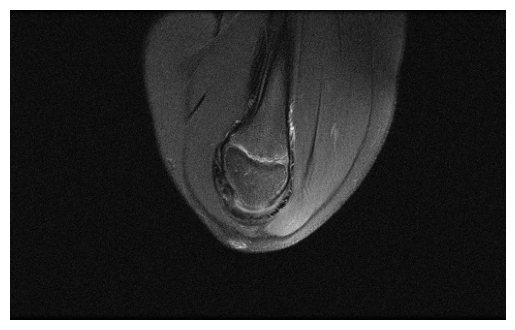

File: 41ea5f8e-c2fb-4f5a-8fde-36bd7a66a2f1.h5, Type: random, Slice: 11


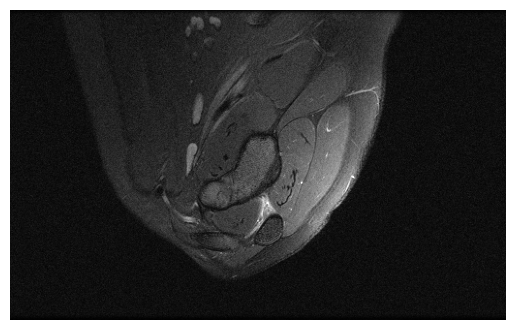

File: 7cdb5257-d2b6-48e7-b29d-88572489f87a.h5, Type: random, Slice: 11


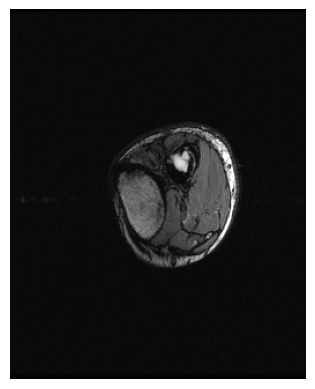

File: 7cdb5257-d2b6-48e7-b29d-88572489f87a.h5, Type: random, Slice: 18


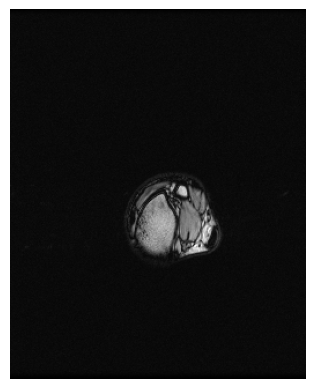

File: be13d3e7-aa50-459f-bb23-dd25a89130c8.h5, Type: random, Slice: 3


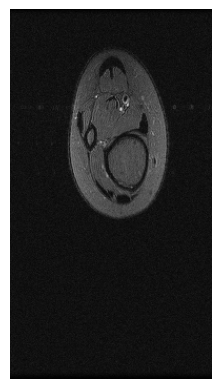

File: 8db4a687-1f9b-4e4c-9078-305875368709.h5, Type: random, Slice: 5


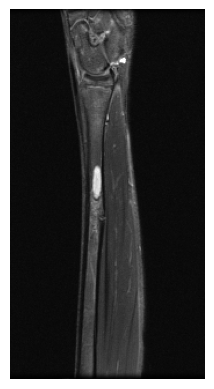

File: daefd846-d57f-4e78-bd49-b2a29efd2623.h5, Type: random, Slice: 8


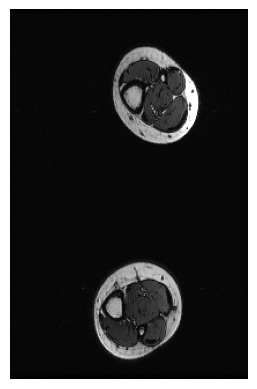

File: 23f32ce4-1be8-41fb-baae-c990a2cd9a6d.h5, Type: random, Slice: 10


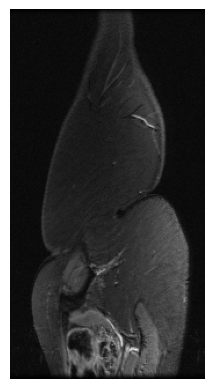

File: 8fed546a-3e3a-471a-8078-0c6a55a1f8aa.h5, Type: random, Slice: 6


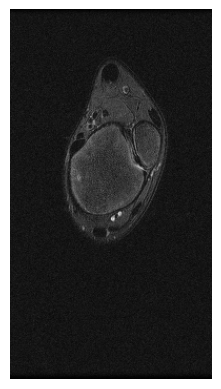

File: 8fed546a-3e3a-471a-8078-0c6a55a1f8aa.h5, Type: random, Slice: 12


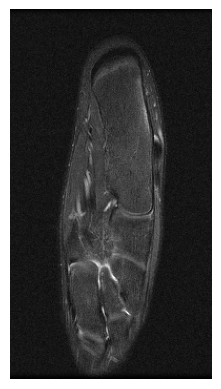

File: 7720d579-7114-4ee8-a28b-0792ff06b0a6.h5, Type: random, Slice: 5


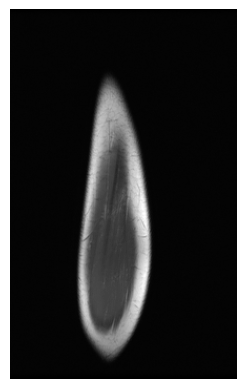

File: 40861cf7-6646-4392-b8a5-0f180ebdb31e.h5, Type: random, Slice: 8


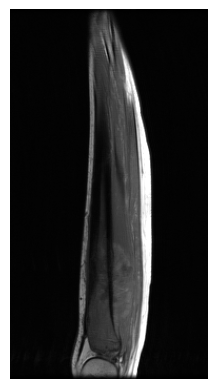

File: 7b2c6a8a-0cff-4eb1-84ed-7dd490563181.h5, Type: random, Slice: 10


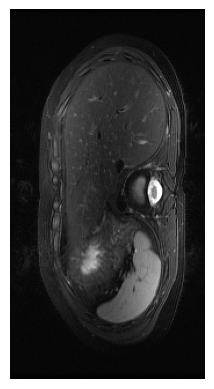

File: 7b2c6a8a-0cff-4eb1-84ed-7dd490563181.h5, Type: random, Slice: 0


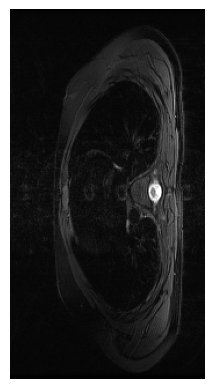

File: 77db8c36-58a3-43e4-a15d-7d2069e7d725.h5, Type: random, Slice: 8


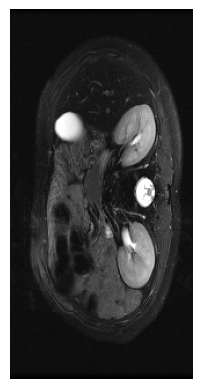

File: 272ac55d-0c3b-4f10-a68f-841a452484a0.h5, Type: random, Slice: 8


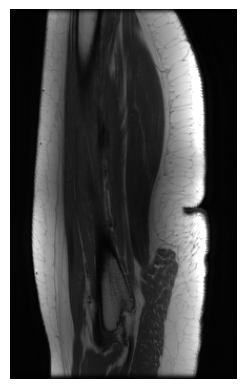

File: 272ac55d-0c3b-4f10-a68f-841a452484a0.h5, Type: random, Slice: 4


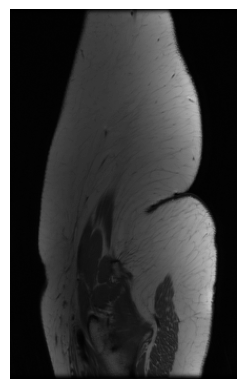

File: 2e8ff5d1-b74c-4860-a5f3-c031104fc4bf.h5, Type: random, Slice: 7


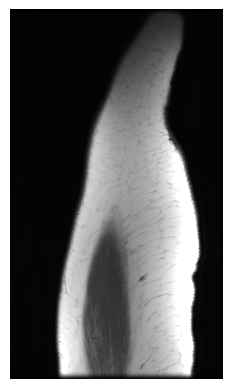

File: 52455c3b-fd2d-4b8a-b24d-e1bd0d37345f.h5, Type: random, Slice: 12


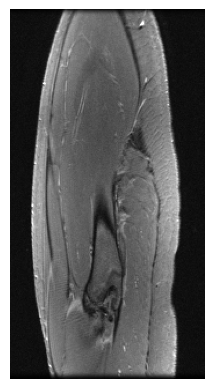

File: b4a9bfe6-c2e5-4e8f-ad30-e95807a55156.h5, Type: random, Slice: 5


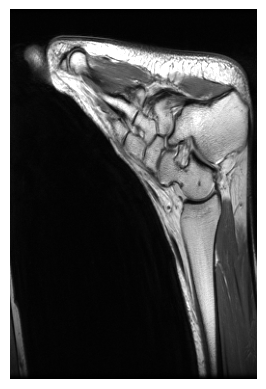

File: b4a9bfe6-c2e5-4e8f-ad30-e95807a55156.h5, Type: random, Slice: 15


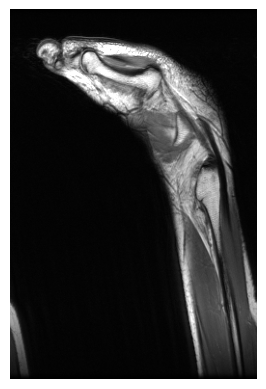

File: dd932c2d-0deb-40ea-9254-7e11055cac59.h5, Type: random, Slice: 3


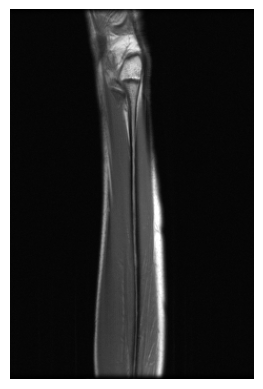

File: 4b00a5ea-2bb8-448b-b9e7-ba497bc3fb7d.h5, Type: random, Slice: 30


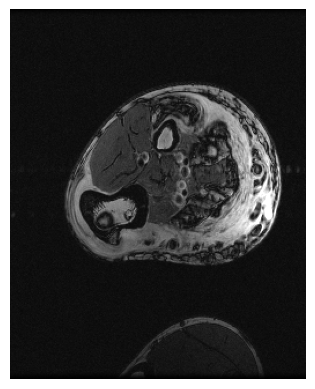

File: 4b00a5ea-2bb8-448b-b9e7-ba497bc3fb7d.h5, Type: random, Slice: 3


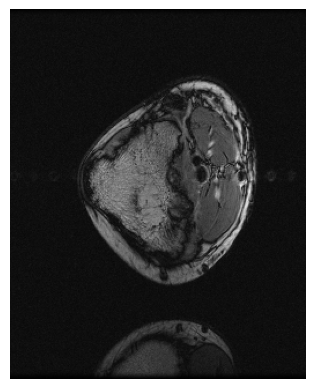

In [5]:
# stanford 2d Total 24 Slices
subset = {}
# random:
subset['random'] = [
 ('41ea5f8e-c2fb-4f5a-8fde-36bd7a66a2f1.h5', 5),
 ('41ea5f8e-c2fb-4f5a-8fde-36bd7a66a2f1.h5', 11),
 ('7cdb5257-d2b6-48e7-b29d-88572489f87a.h5', 11),
 ('7cdb5257-d2b6-48e7-b29d-88572489f87a.h5', 18),
 ('be13d3e7-aa50-459f-bb23-dd25a89130c8.h5', 3),
 ('8db4a687-1f9b-4e4c-9078-305875368709.h5', 5),
 ('daefd846-d57f-4e78-bd49-b2a29efd2623.h5', 8),
 ('23f32ce4-1be8-41fb-baae-c990a2cd9a6d.h5', 10),
 ('8fed546a-3e3a-471a-8078-0c6a55a1f8aa.h5', 6),
 ('8fed546a-3e3a-471a-8078-0c6a55a1f8aa.h5', 12),
 ('7720d579-7114-4ee8-a28b-0792ff06b0a6.h5', 5),
 ('40861cf7-6646-4392-b8a5-0f180ebdb31e.h5', 8),
 ('7b2c6a8a-0cff-4eb1-84ed-7dd490563181.h5', 10),
 ('7b2c6a8a-0cff-4eb1-84ed-7dd490563181.h5', 0),
 ('77db8c36-58a3-43e4-a15d-7d2069e7d725.h5', 8),
 ('272ac55d-0c3b-4f10-a68f-841a452484a0.h5', 8),
 ('272ac55d-0c3b-4f10-a68f-841a452484a0.h5', 4),
 ('2e8ff5d1-b74c-4860-a5f3-c031104fc4bf.h5', 7),
 ('52455c3b-fd2d-4b8a-b24d-e1bd0d37345f.h5', 12),
 ('b4a9bfe6-c2e5-4e8f-ad30-e95807a55156.h5', 5),
 ('b4a9bfe6-c2e5-4e8f-ad30-e95807a55156.h5', 15),
 ('dd932c2d-0deb-40ea-9254-7e11055cac59.h5', 3),
 ('4b00a5ea-2bb8-448b-b9e7-ba497bc3fb7d.h5', 30),
 ('4b00a5ea-2bb8-448b-b9e7-ba497bc3fb7d.h5', 3)
]

path_to_json = 'datasets/evals/classic/stanford_2d.json'
with open(path_to_json) as f:
    json_data = json.load(f)

plot_subset(subset, json_data)

# save_nuanced_subset(subset, json_data)

File: 7d1e0fb6-0a43-4548-980c-4f0cdb20c367.h5, Type: cor_pd, Slice: 5


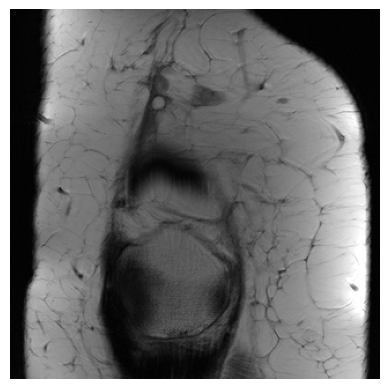

File: 993716e9-b5f0-4c30-a059-c003182d0f9c.h5, Type: cor_pd, Slice: 10


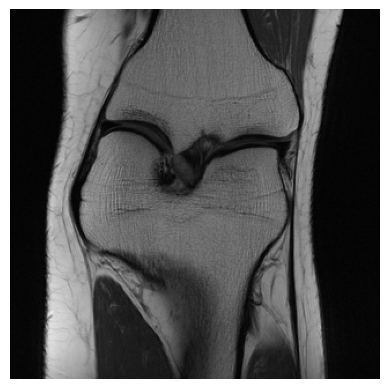

File: 7d1e0fb6-0a43-4548-980c-4f0cdb20c367.h5, Type: cor_pd, Slice: 20


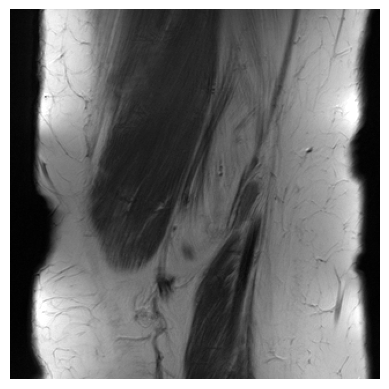

File: 3dafaac6-e40a-45c3-a285-c88944e72dab.h5, Type: cor_pd, Slice: 26


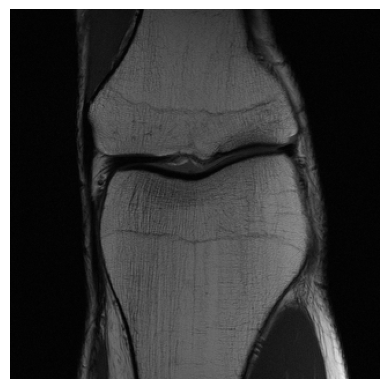

File: 993716e9-b5f0-4c30-a059-c003182d0f9c.h5, Type: cor_pd, Slice: 30


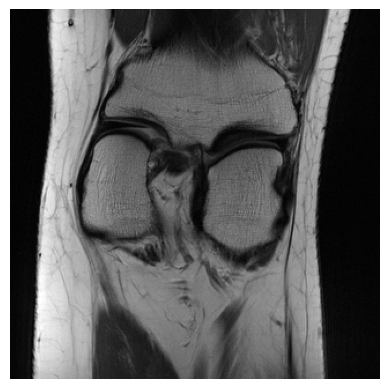

File: edb3e7ff-463c-433e-94cf-700ed004365e.h5, Type: cor_pdfs, Slice: 5


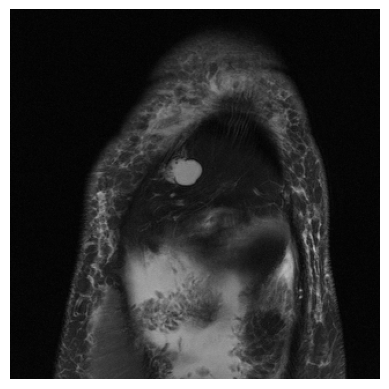

File: 6c10376d-2825-4275-9d37-7cbac95b73d1.h5, Type: cor_pdfs, Slice: 10


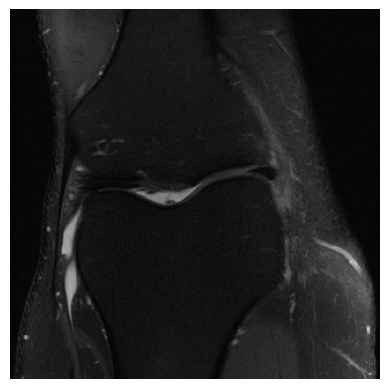

File: 3578cd98-650c-4489-884e-7e162202b961.h5, Type: cor_pdfs, Slice: 21


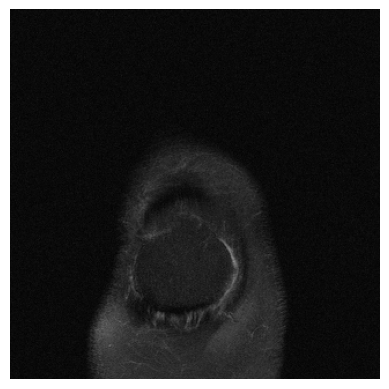

File: 812594f8-1bbb-4855-8de8-9b24beb68dcc.h5, Type: cor_pdfs, Slice: 26


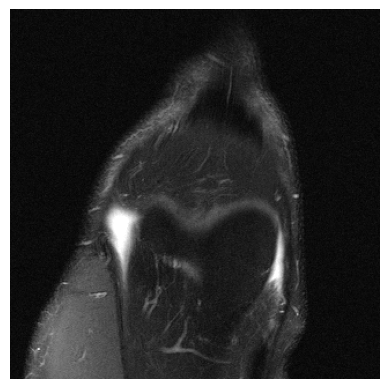

File: 9d4b66ea-e3db-4ea8-b3a8-1e6c2642e6d9.h5, Type: cor_pdfs, Slice: 30


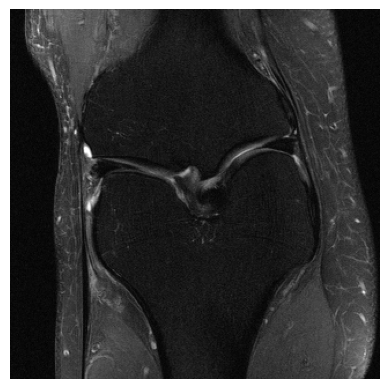

File: ac9a60ce-3d72-41c8-a0e7-a29d2022fd86.h5, Type: ax_t2fs, Slice: 5


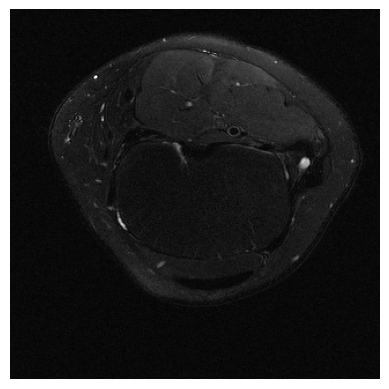

File: 14b0b5bd-25f4-4e6c-aa50-5a0048a495f8.h5, Type: ax_t2fs, Slice: 10


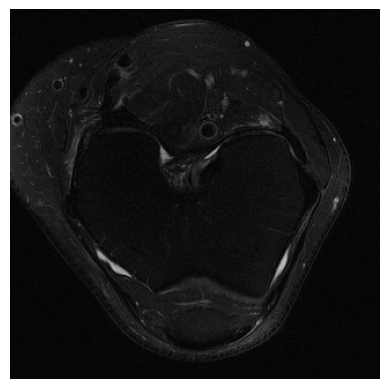

File: 36cb711d-5a2d-449a-b381-ab01c913055e.h5, Type: ax_t2fs, Slice: 21


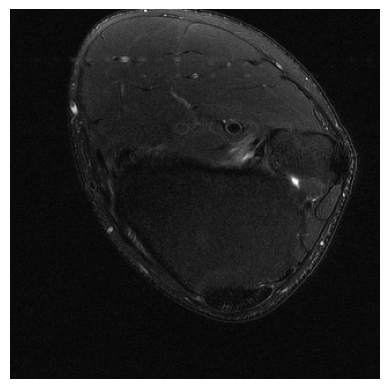

File: ac9a60ce-3d72-41c8-a0e7-a29d2022fd86.h5, Type: ax_t2fs, Slice: 26


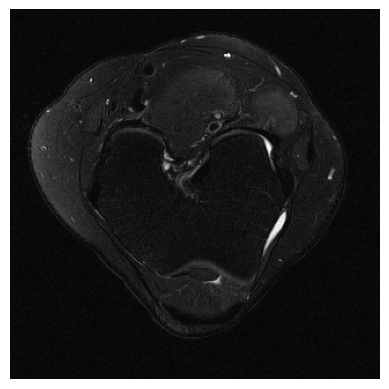

File: 36cb711d-5a2d-449a-b381-ab01c913055e.h5, Type: ax_t2fs, Slice: 30


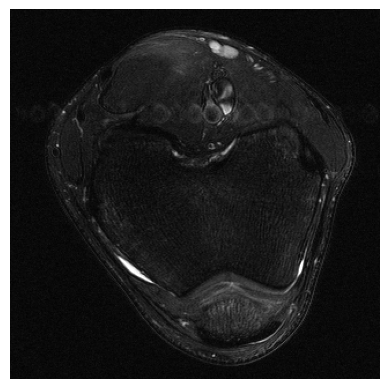

File: bde64419-c4c3-4a7f-be23-b38ae6f67454.h5, Type: sag_t2fs, Slice: 5


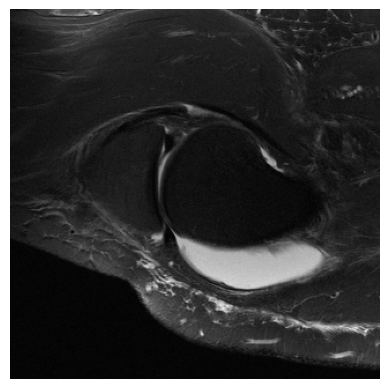

File: a48786e2-75f8-4c09-8dcc-a3ee20b9ae81.h5, Type: sag_t2fs, Slice: 10


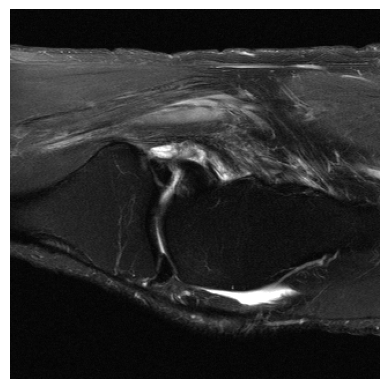

File: 413d7d8f-4644-4bef-86e2-89f01cd84215.h5, Type: sag_t2fs, Slice: 21


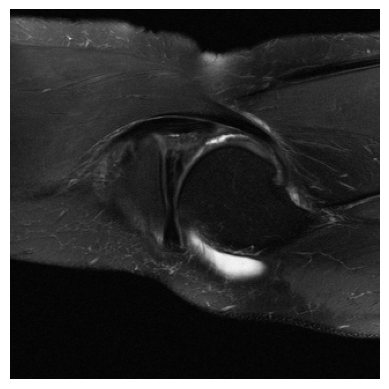

File: bde64419-c4c3-4a7f-be23-b38ae6f67454.h5, Type: sag_t2fs, Slice: 26


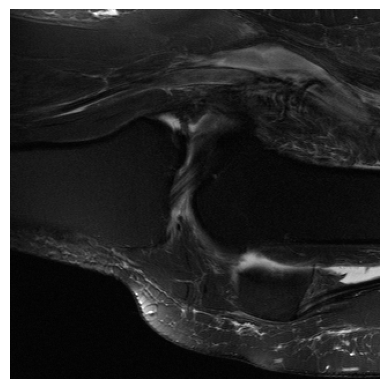

File: c5313660-3d9f-4337-815d-cb9dbf35e55a.h5, Type: sag_t2fs, Slice: 30


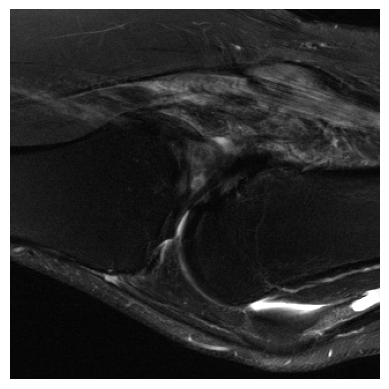

File: bd01dd30-46e7-4415-bf04-ed4cc6ac2b64.h5, Type: sag_pd, Slice: 5


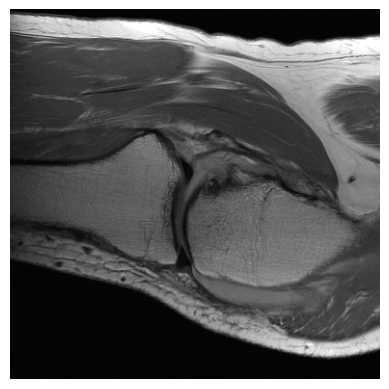

File: 48c95dcf-c074-499b-a63c-74f0bf7dff1f.h5, Type: sag_pd, Slice: 10


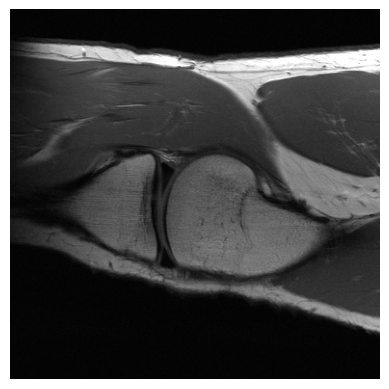

File: cafc2ace-a826-4344-8cf9-896ec8bc6120.h5, Type: sag_pd, Slice: 21


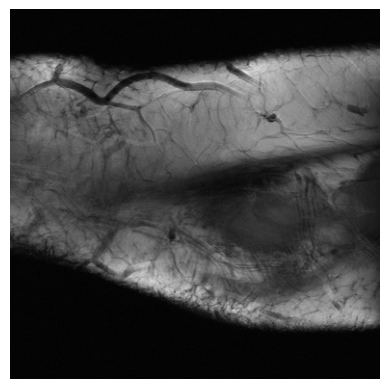

File: bd01dd30-46e7-4415-bf04-ed4cc6ac2b64.h5, Type: sag_pd, Slice: 26


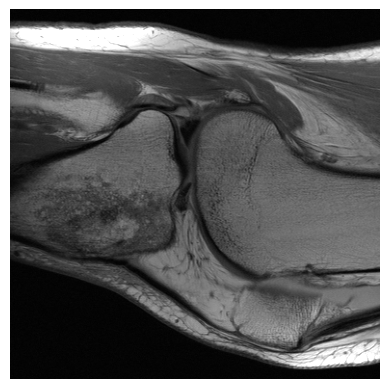

File: cafc2ace-a826-4344-8cf9-896ec8bc6120.h5, Type: sag_pd, Slice: 29


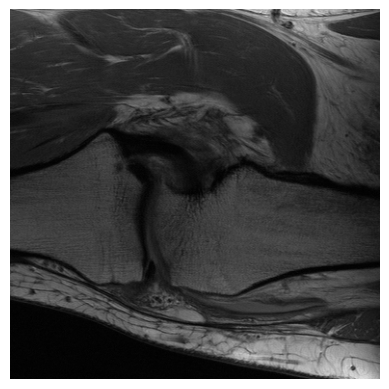

In [6]:
# nyu 2d: Total 15 Slices
# 3 x PD 1.5T, 3 x PD 3.0T, 3 x PDFS 1.5T, 3 x PDFS 3.0T

subset = {}
# Coronal PD:
subset['cor_pd'] = [('7d1e0fb6-0a43-4548-980c-4f0cdb20c367.h5', 5), ('993716e9-b5f0-4c30-a059-c003182d0f9c.h5', 10), ('7d1e0fb6-0a43-4548-980c-4f0cdb20c367.h5', 20), ('3dafaac6-e40a-45c3-a285-c88944e72dab.h5', 26), ('993716e9-b5f0-4c30-a059-c003182d0f9c.h5', 30),]
# Coronal PDFS:
subset['cor_pdfs'] = [('edb3e7ff-463c-433e-94cf-700ed004365e.h5', 5), ('6c10376d-2825-4275-9d37-7cbac95b73d1.h5', 10), ('3578cd98-650c-4489-884e-7e162202b961.h5', 21), ('812594f8-1bbb-4855-8de8-9b24beb68dcc.h5', 26), ('9d4b66ea-e3db-4ea8-b3a8-1e6c2642e6d9.h5', 30),]
# Axial T2FS:
subset['ax_t2fs'] = [('ac9a60ce-3d72-41c8-a0e7-a29d2022fd86.h5', 5), ('14b0b5bd-25f4-4e6c-aa50-5a0048a495f8.h5', 10), ('36cb711d-5a2d-449a-b381-ab01c913055e.h5', 21), ('ac9a60ce-3d72-41c8-a0e7-a29d2022fd86.h5', 26), ('36cb711d-5a2d-449a-b381-ab01c913055e.h5', 30),]
# Sagittal T2FS:
subset['sag_t2fs'] = [('bde64419-c4c3-4a7f-be23-b38ae6f67454.h5', 5), ('a48786e2-75f8-4c09-8dcc-a3ee20b9ae81.h5', 10), ('413d7d8f-4644-4bef-86e2-89f01cd84215.h5', 21), ('bde64419-c4c3-4a7f-be23-b38ae6f67454.h5', 26), ('c5313660-3d9f-4337-815d-cb9dbf35e55a.h5', 30),]
# Sagittal PD
subset['sag_pd'] = [('bd01dd30-46e7-4415-bf04-ed4cc6ac2b64.h5', 5), ('48c95dcf-c074-499b-a63c-74f0bf7dff1f.h5', 10), ('cafc2ace-a826-4344-8cf9-896ec8bc6120.h5', 21), ('bd01dd30-46e7-4415-bf04-ed4cc6ac2b64.h5', 26), ('cafc2ace-a826-4344-8cf9-896ec8bc6120.h5', 29),]

path_to_json = 'datasets/evals/classic/nyu_2d.json'
with open(path_to_json) as f:
    json_data = json.load(f)

# print('All files in eval dataset:', check_existence(subset, json_data))

plot_subset(subset, json_data)

# save_nuanced_subset(subset, json_data)

File: 2022121702_T104.h5, Type: t1, Slice: 2


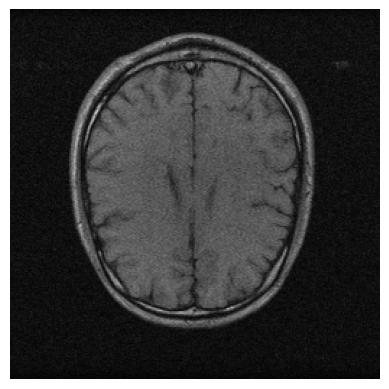

File: 2022101302_T104.h5, Type: t1, Slice: 6


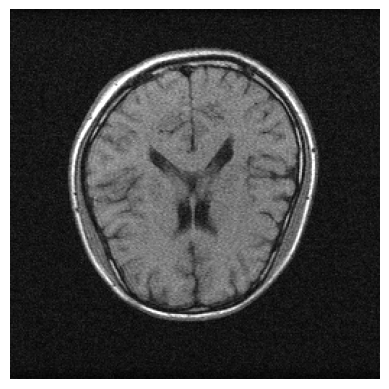

File: 2022101302_T101.h5, Type: t1, Slice: 10


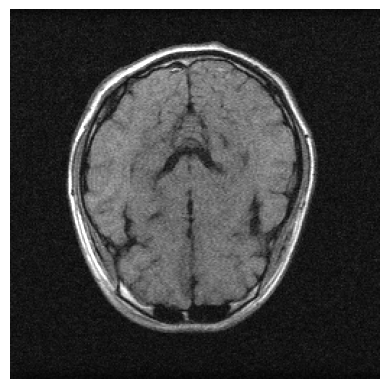

File: 2022121706_T103.h5, Type: t1, Slice: 13


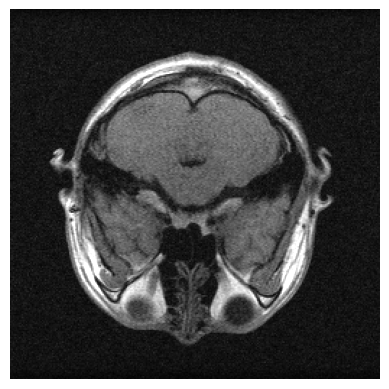

File: 2022120409_T104.h5, Type: t1, Slice: 16


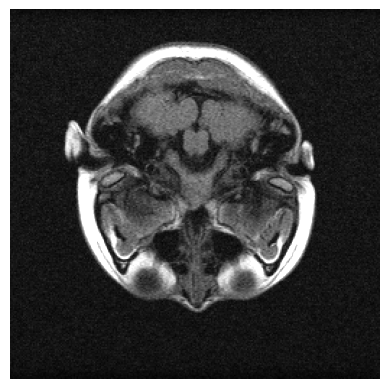

File: 2022101101_T202.h5, Type: t2, Slice: 2


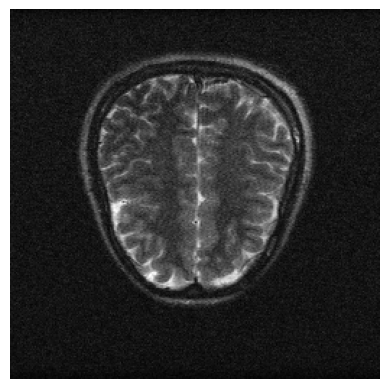

File: 2022112704_T203.h5, Type: t2, Slice: 6


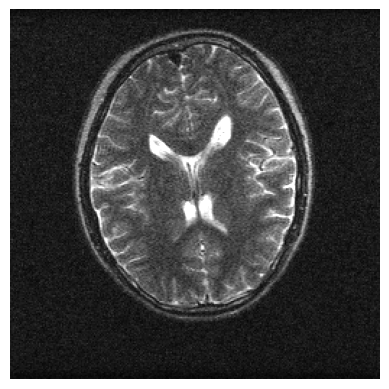

File: 2022121702_T206.h5, Type: t2, Slice: 10


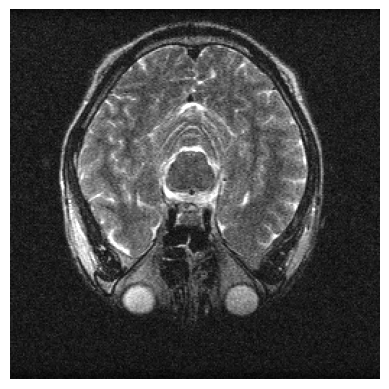

File: 2022101204_T201.h5, Type: t2, Slice: 13


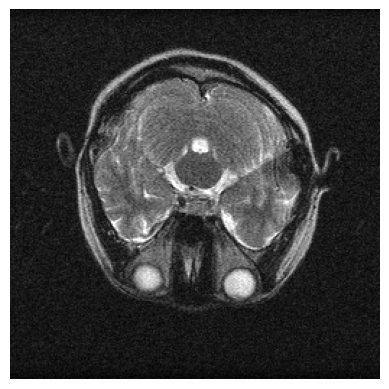

File: 2022121706_T201.h5, Type: t2, Slice: 16


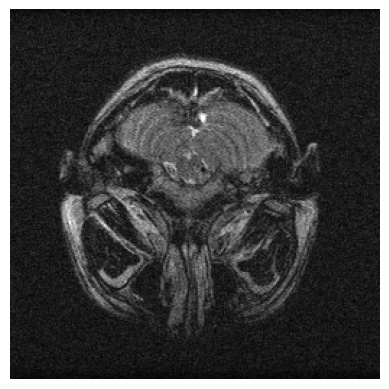

File: 2022112704_FLAIR01.h5, Type: flair, Slice: 2


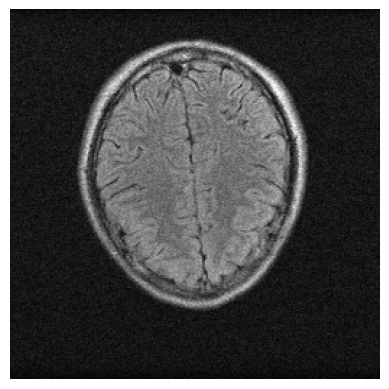

File: 2022121706_FLAIR03.h5, Type: flair, Slice: 6


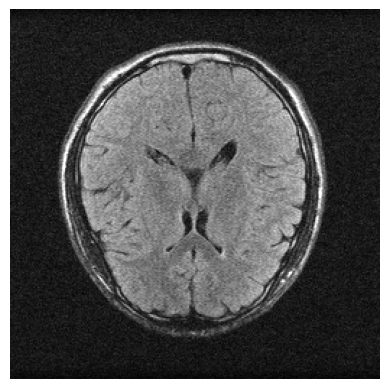

File: 2022101302_FLAIR02.h5, Type: flair, Slice: 10


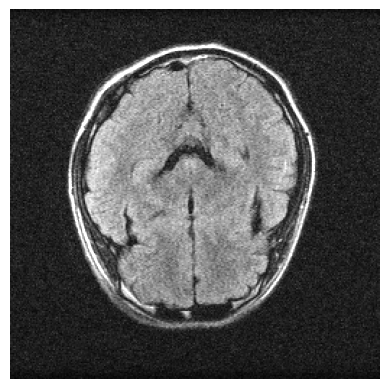

File: 2022120409_FLAIR04.h5, Type: flair, Slice: 13


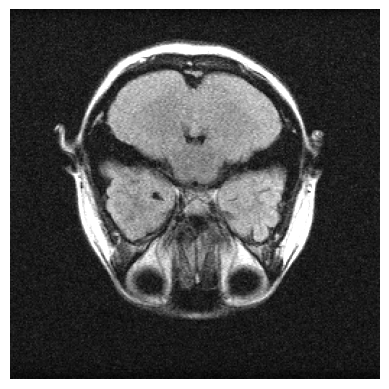

File: 2022120401_FLAIR01.h5, Type: flair, Slice: 16


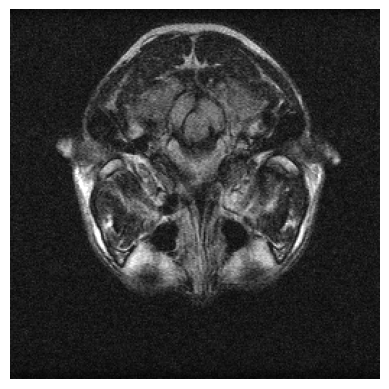

In [7]:
# M4Raw: Total 15 Slices
# 5 x T1, 5 x T2, 5 x FLAIR

subset = {}
# t1:
subset['t1'] = [('2022121702_T104.h5', 2), ('2022101302_T104.h5', 6), ('2022101302_T101.h5', 10), ('2022121706_T103.h5', 13), ('2022120409_T104.h5', 16)]
# t2:
subset['t2'] = [('2022101101_T202.h5', 2), ('2022112704_T203.h5', 6), ('2022121702_T206.h5', 10), ( '2022101204_T201.h5', 13), ('2022121706_T201.h5', 16)]
# flair:
subset['flair'] = [('2022112704_FLAIR01.h5', 2), ('2022121706_FLAIR03.h5', 6), ('2022101302_FLAIR02.h5', 10), ('2022120409_FLAIR04.h5', 13), ('2022120401_FLAIR01.h5', 16)]


path_to_json = 'datasets/evals/classic/m4raw.json'
with open(path_to_json) as f:
    json_data = json.load(f)

# print('All files in eval dataset:', check_existence(subset, json_data))

plot_subset(subset, json_data)

# save_nuanced_subset(subset, json_data)

File: 2022090602_GRE02.h5, Type: random, Slice: 0


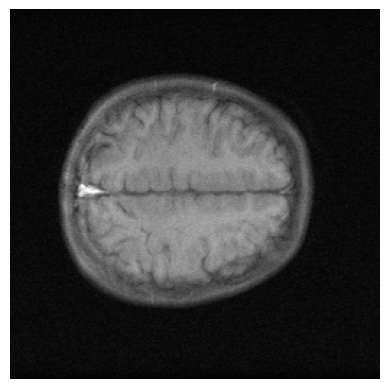

File: 2022061302_GRE01.h5, Type: random, Slice: 1


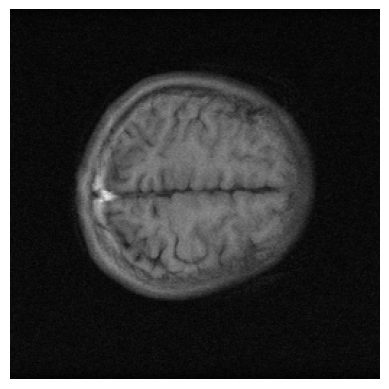

File: 2022092502_GRE02.h5, Type: random, Slice: 2


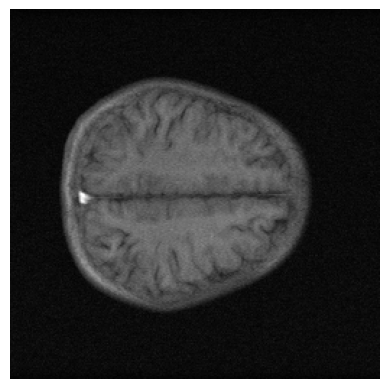

File: 2022061206_GRE01.h5, Type: random, Slice: 3


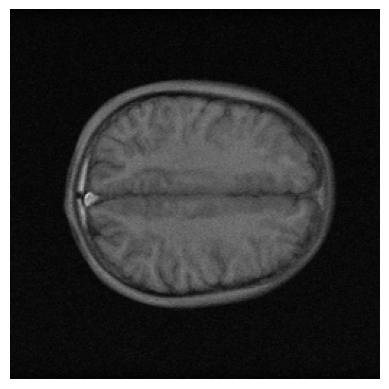

File: 2022091408_GRE02.h5, Type: random, Slice: 4


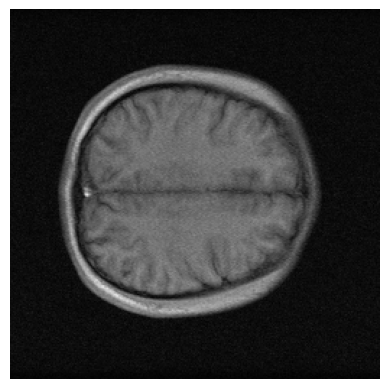

File: 2022090305_GRE02.h5, Type: random, Slice: 6


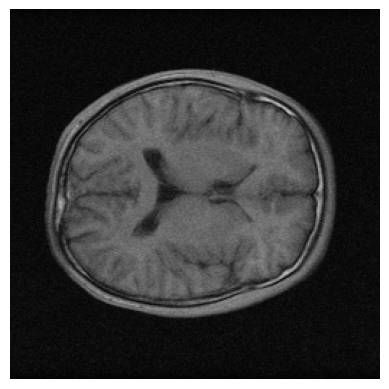

File: 2022090603_GRE01.h5, Type: random, Slice: 8


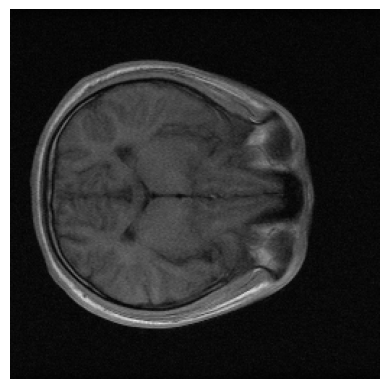

File: 2022062616_GRE02.h5, Type: random, Slice: 10


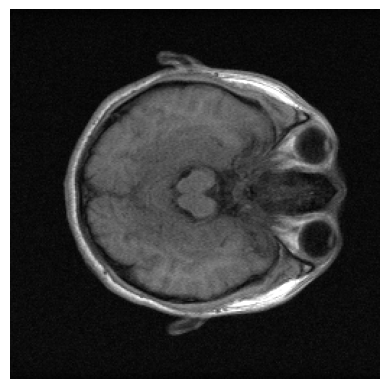

File: 2022061203_GRE02.h5, Type: random, Slice: 12


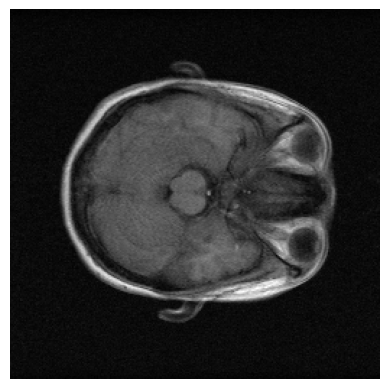

File: 2022090503_GRE01.h5, Type: random, Slice: 14


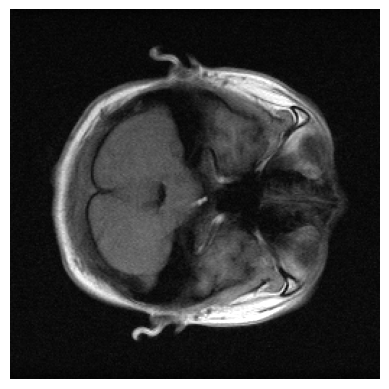

In [8]:
# M4RawGRE: Total 10 Slices
# 10 x random selection

subset = {}
subset['random'] = [ 
    ('2022090602_GRE02.h5', 0),  ('2022061302_GRE01.h5', 1), ('2022092502_GRE02.h5', 2), ('2022061206_GRE01.h5', 3), ('2022091408_GRE02.h5', 4), 
    ('2022090305_GRE02.h5', 6), ('2022090603_GRE01.h5', 8), ('2022062616_GRE02.h5', 10), ('2022061203_GRE02.h5', 12), ('2022090503_GRE01.h5', 14), 
    ]
 

path_to_json = 'datasets/evals/classic/m4raw_gre_rot.json'
with open(path_to_json) as f:
    json_data = json.load(f)

# print('All files in eval dataset:', check_existence(subset, json_data))

plot_subset(subset, json_data)

# save_nuanced_subset(subset, json_data)

File: knee_TSE_V1_conventional.h5, Type: knee_conventional, Slice: 21


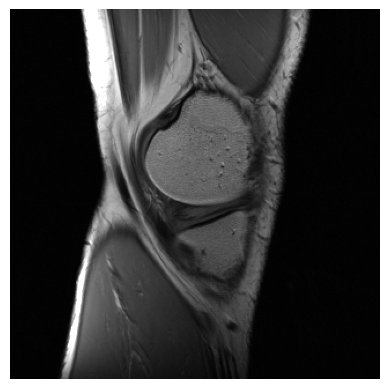

File: knee_TSE_V2_conventional.h5, Type: knee_conventional, Slice: 15


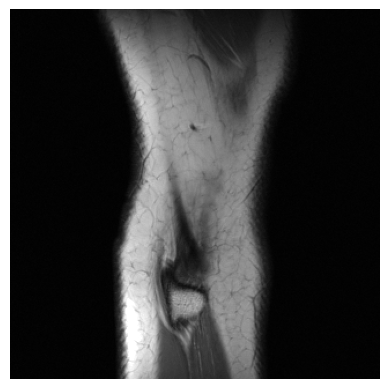

File: knee_TSE_V3_conventional.h5, Type: knee_conventional, Slice: 28


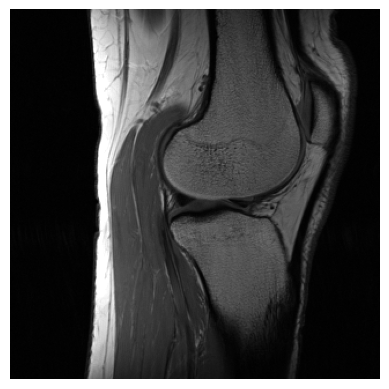

File: knee_TSE_V1_conventional.h5, Type: knee_conventional, Slice: 9


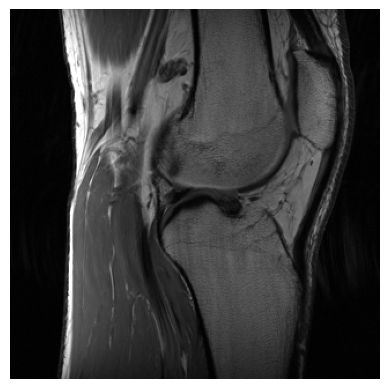

File: knee_TSE_V3_conventional.h5, Type: knee_conventional, Slice: 3


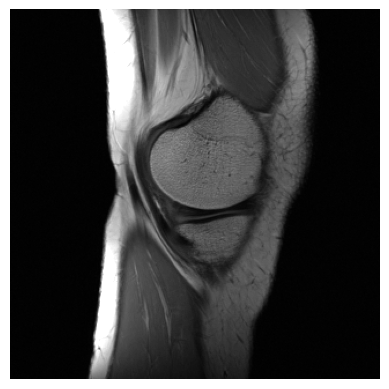

File: knee_TSE_V1_waterSat.h5, Type: knee_watersat, Slice: 21


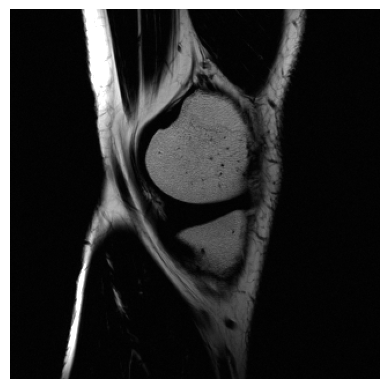

File: knee_TSE_V2_waterSat.h5, Type: knee_watersat, Slice: 15


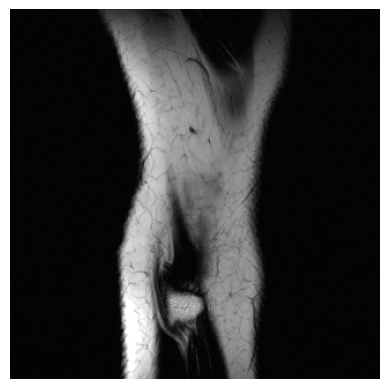

File: knee_TSE_V3_waterSat.h5, Type: knee_watersat, Slice: 28


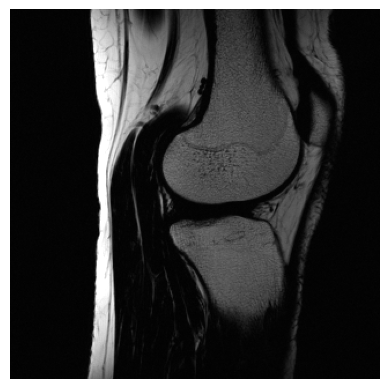

File: knee_TSE_V1_waterSat.h5, Type: knee_watersat, Slice: 9


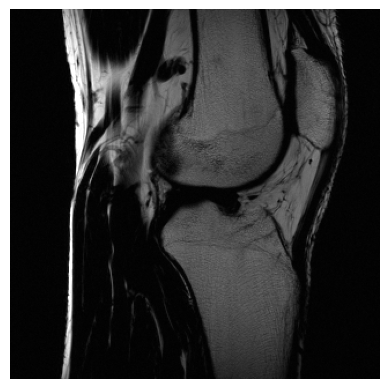

File: knee_TSE_V3_waterSat.h5, Type: knee_watersat, Slice: 3


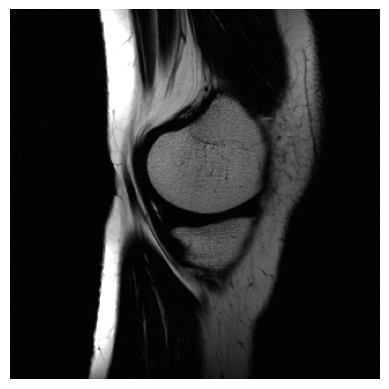

File: knee_TSE_V1_fatSat.h5, Type: knee_fatsat, Slice: 21


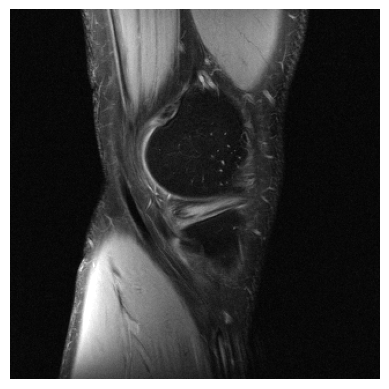

File: knee_TSE_V2_fatSat.h5, Type: knee_fatsat, Slice: 15


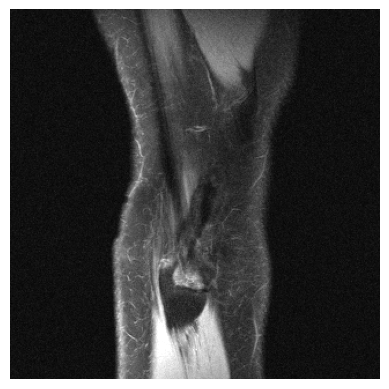

File: knee_TSE_V3_fatSat.h5, Type: knee_fatsat, Slice: 28


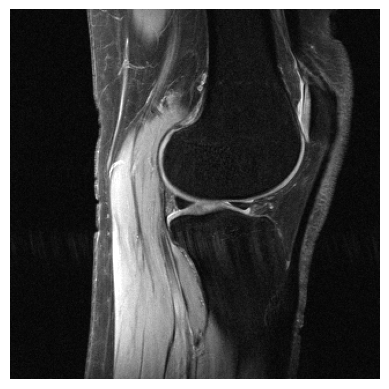

File: knee_TSE_V1_fatSat.h5, Type: knee_fatsat, Slice: 9


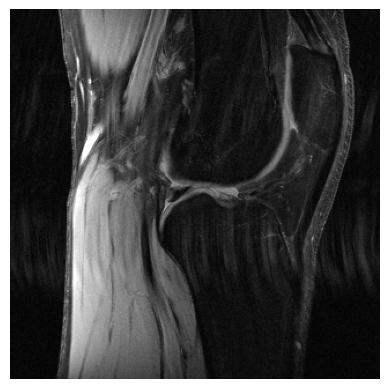

File: knee_TSE_V3_fatSat.h5, Type: knee_fatsat, Slice: 3


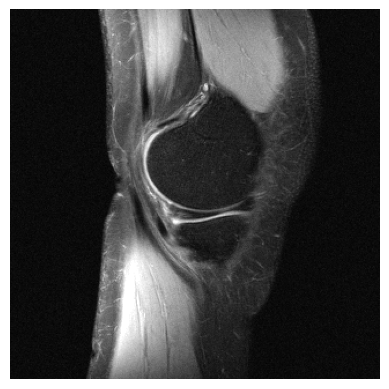

File: knee_TSE_V3_2ptDixon_m0.h5, Type: knee_dixon, Slice: 21


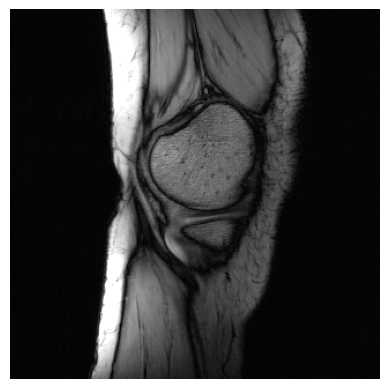

File: knee_TSE_V3_2ptDixon_m1.h5, Type: knee_dixon, Slice: 15


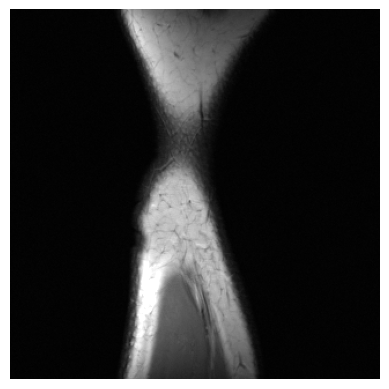

File: knee_TSE_V2_2ptDixon_m0.h5, Type: knee_dixon, Slice: 28


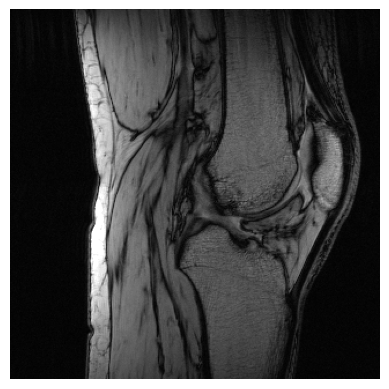

File: knee_TSE_V2_2ptDixon_m1.h5, Type: knee_dixon, Slice: 9


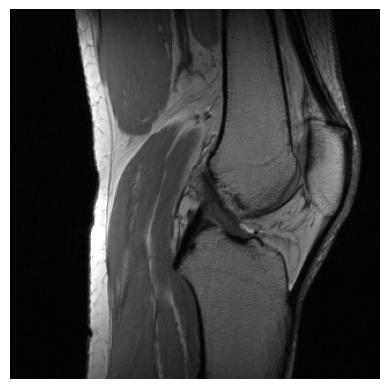

File: knee_TSE_V1_2ptDixon_m0.h5, Type: knee_dixon, Slice: 3


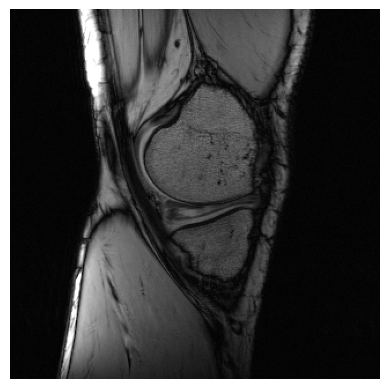

File: breasts_GRE_V4_conventional.h5, Type: breast_conventional, Slice: 1


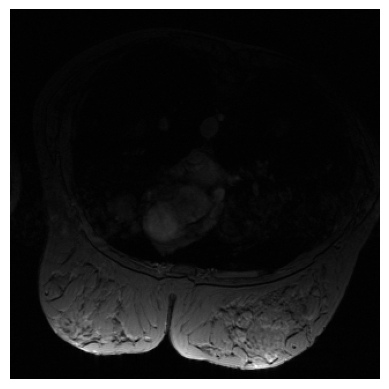

File: breasts_GRE_V5_conventional.h5, Type: breast_conventional, Slice: 2


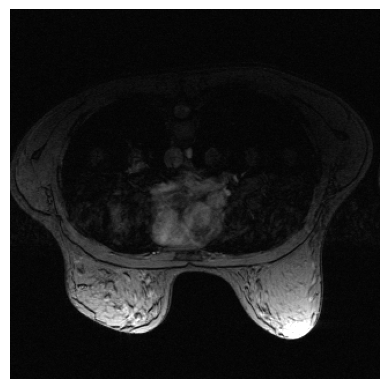

File: breasts_GRE_V6_conventional.h5, Type: breast_conventional, Slice: 3


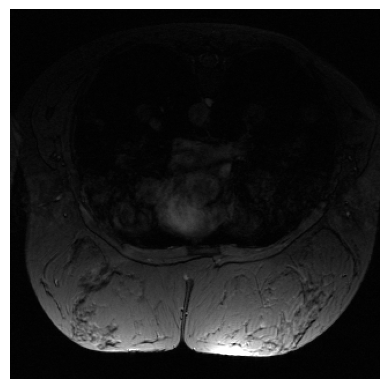

File: breasts_GRE_V4_conventional.h5, Type: breast_conventional, Slice: 4


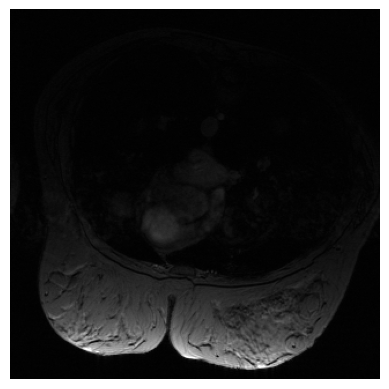

File: breasts_GRE_V6_conventional.h5, Type: breast_conventional, Slice: 0


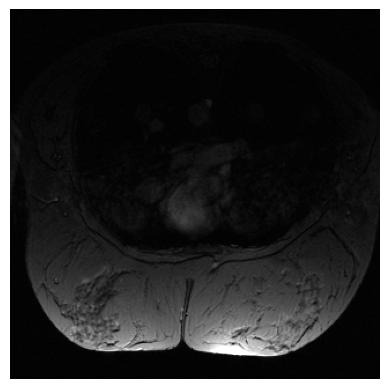

File: breasts_GRE_V4_waterSat.h5, Type: breast_watersat, Slice: 2


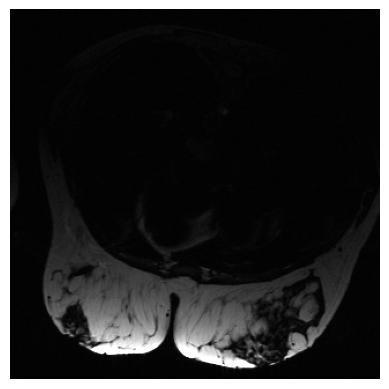

File: breasts_GRE_V5_waterSat.h5, Type: breast_watersat, Slice: 3


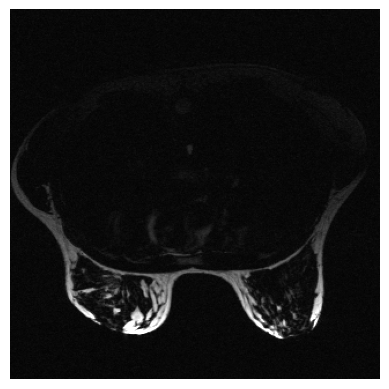

File: breasts_GRE_V6_waterSat.h5, Type: breast_watersat, Slice: 1


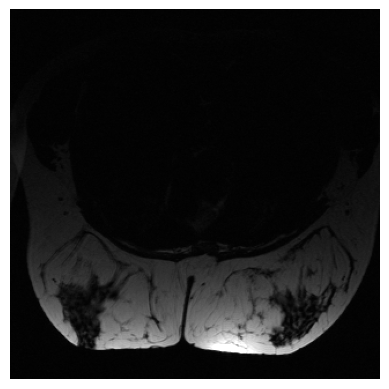

File: breasts_GRE_V4_waterSat.h5, Type: breast_watersat, Slice: 3


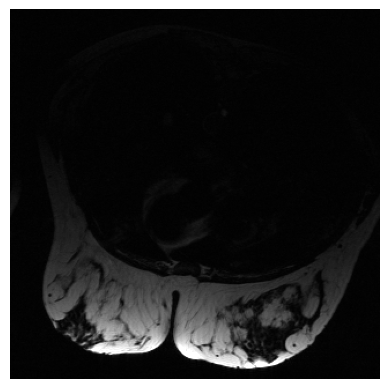

File: breasts_GRE_V6_waterSat.h5, Type: breast_watersat, Slice: 3


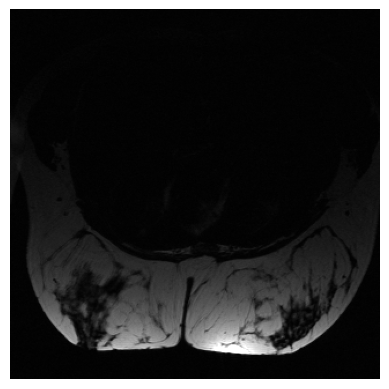

File: breasts_GRE_V4_fatSat.h5, Type: breast_fatsat, Slice: 2


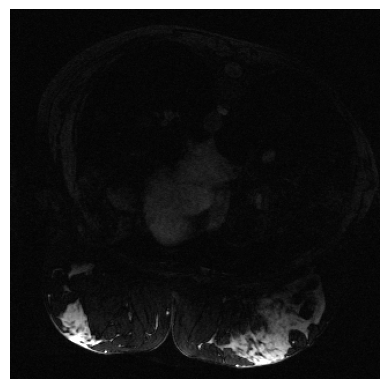

File: breasts_GRE_V5_fatSat.h5, Type: breast_fatsat, Slice: 3


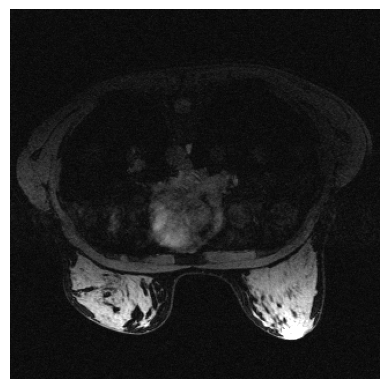

File: breasts_GRE_V6_fatSat.h5, Type: breast_fatsat, Slice: 1


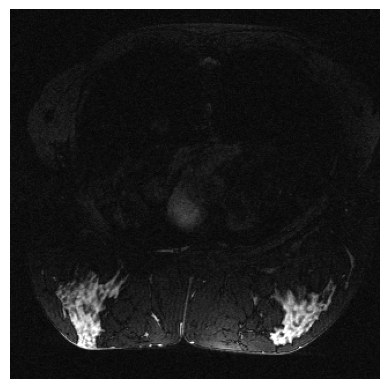

File: breasts_GRE_V4_fatSat.h5, Type: breast_fatsat, Slice: 3


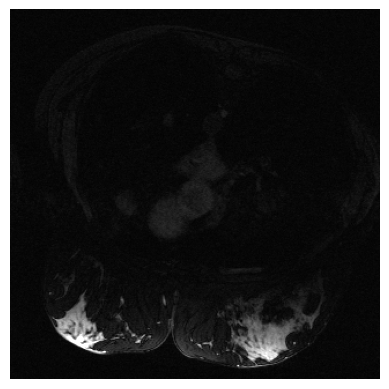

File: breasts_GRE_V6_fatSat.h5, Type: breast_fatsat, Slice: 3


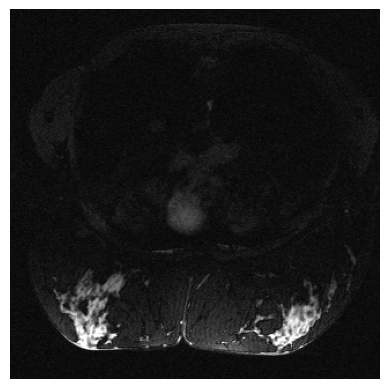

File: breasts_GRE_V6_2D3ptDixon_m0.h5, Type: breast_dixon, Slice: 1


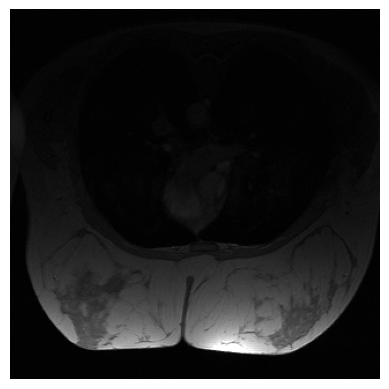

File: breasts_GRE_V6_2D3ptDixon_m1.h5, Type: breast_dixon, Slice: 2


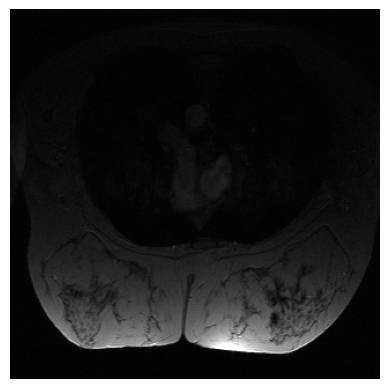

File: breasts_GRE_V5_2D3ptDixon_m0.h5, Type: breast_dixon, Slice: 3


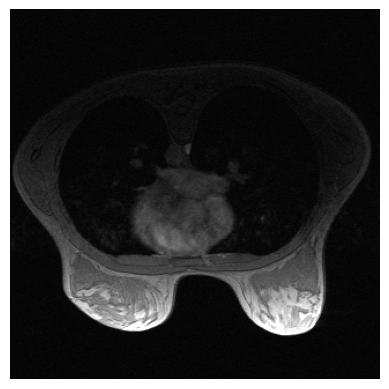

File: breasts_GRE_V5_2D3ptDixon_m1.h5, Type: breast_dixon, Slice: 0


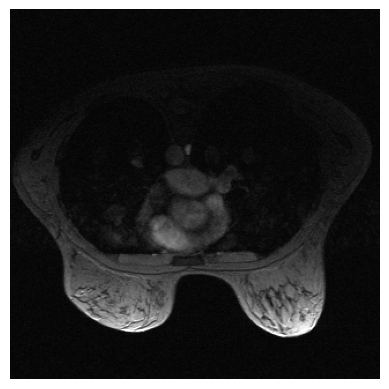

File: breasts_GRE_V4_2D3ptDixon_m0.h5, Type: breast_dixon, Slice: 4


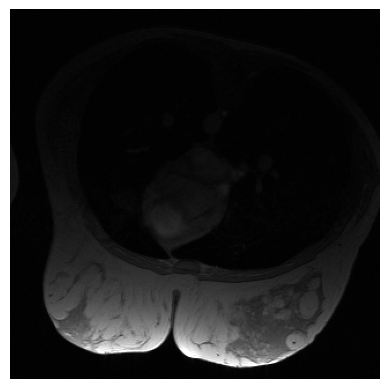

File: abdomen_GRE_V7_conventional.h5, Type: abdomen_conventional, Slice: 1


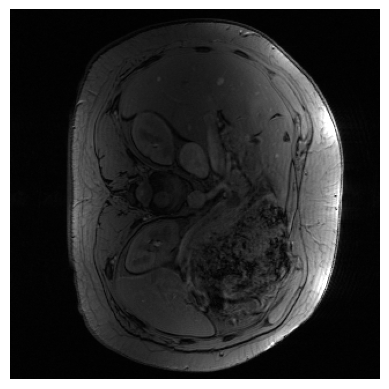

File: abdomen_GRE_V8_conventional.h5, Type: abdomen_conventional, Slice: 2


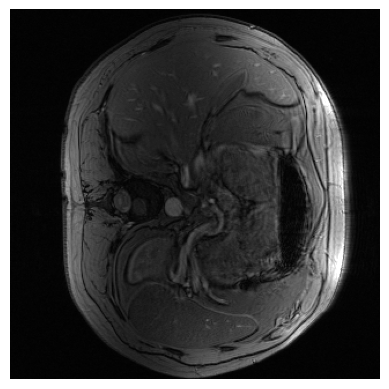

File: abdomen_GRE_V9_conventional.h5, Type: abdomen_conventional, Slice: 3


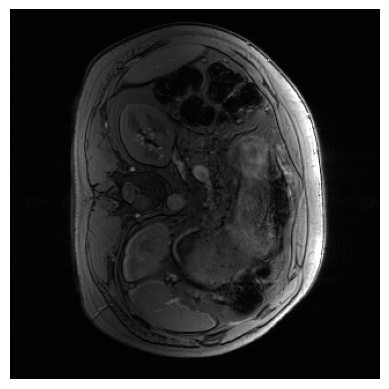

File: abdomen_GRE_V7_conventional.h5, Type: abdomen_conventional, Slice: 4


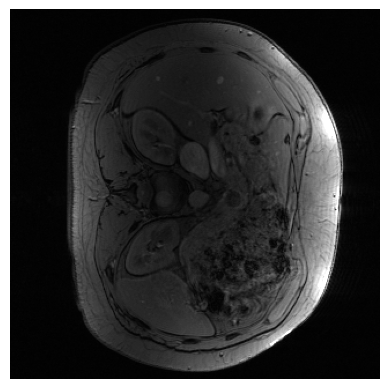

File: abdomen_GRE_V9_conventional.h5, Type: abdomen_conventional, Slice: 0


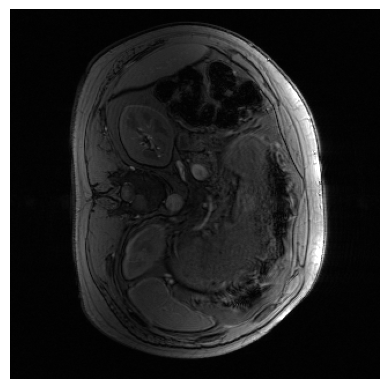

File: abdomen_GRE_V7_waterSat.h5, Type: abdomen_watersat, Slice: 3


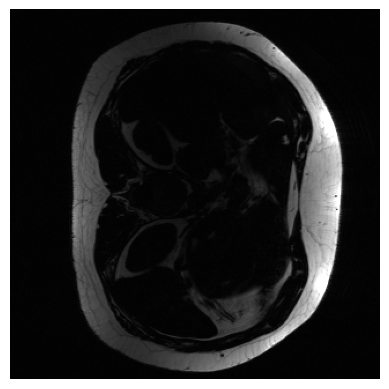

File: abdomen_GRE_V8_waterSat.h5, Type: abdomen_watersat, Slice: 0


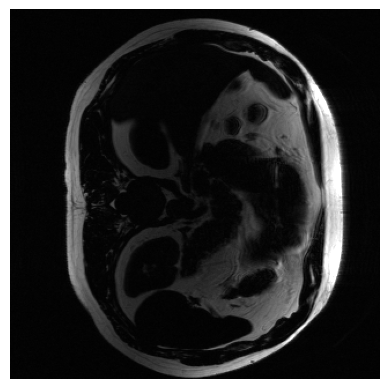

File: abdomen_GRE_V9_waterSat.h5, Type: abdomen_watersat, Slice: 1


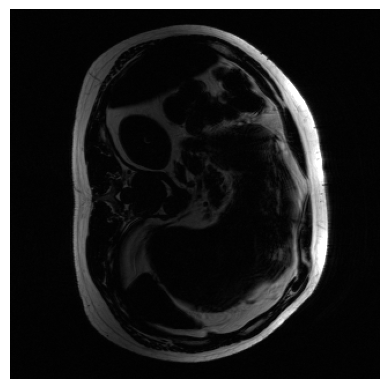

File: abdomen_GRE_V7_waterSat.h5, Type: abdomen_watersat, Slice: 2


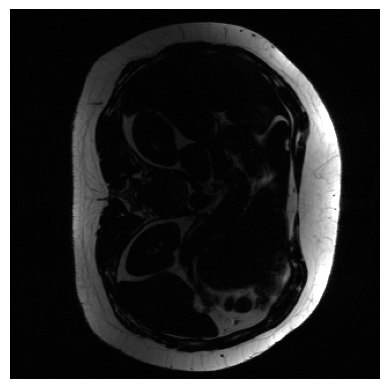

File: abdomen_GRE_V9_waterSat.h5, Type: abdomen_watersat, Slice: 3


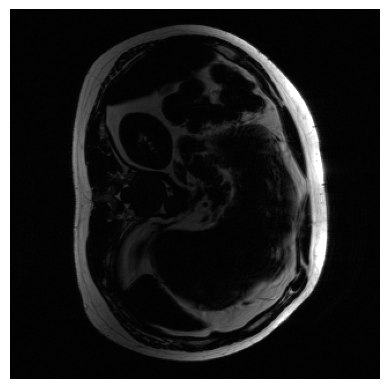

File: abdomen_GRE_V7_fatSat.h5, Type: abdomen_fatsat, Slice: 3


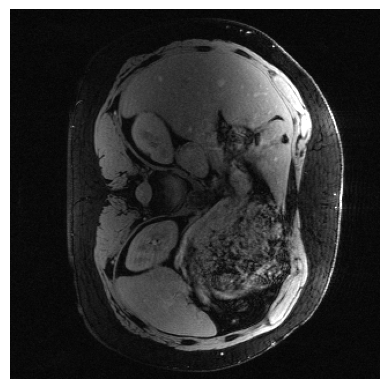

File: abdomen_GRE_V8_fatSat.h5, Type: abdomen_fatsat, Slice: 0


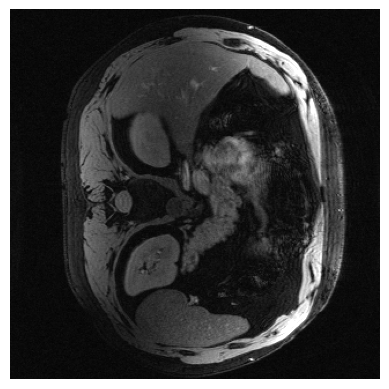

File: abdomen_GRE_V9_fatSat.h5, Type: abdomen_fatsat, Slice: 1


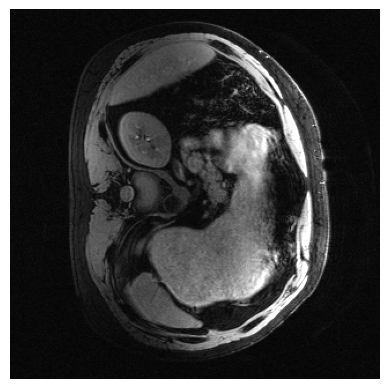

File: abdomen_GRE_V7_fatSat.h5, Type: abdomen_fatsat, Slice: 2


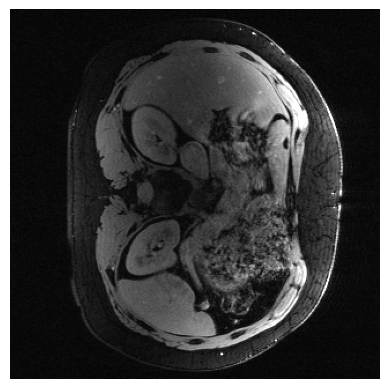

File: abdomen_GRE_V9_fatSat.h5, Type: abdomen_fatsat, Slice: 3


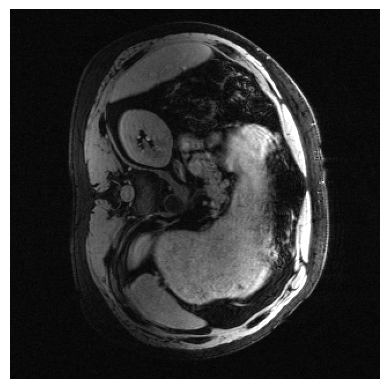

File: abdomen_GRE_V9_2D3ptDixon_m0.h5, Type: abdomen_dixon, Slice: 1


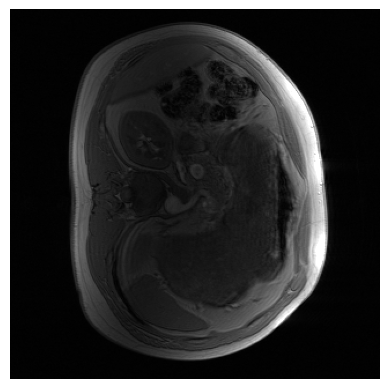

File: abdomen_GRE_V9_2D3ptDixon_m1.h5, Type: abdomen_dixon, Slice: 2


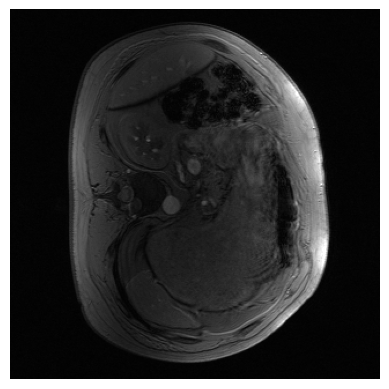

File: abdomen_GRE_V8_2D3ptDixon_m0.h5, Type: abdomen_dixon, Slice: 0


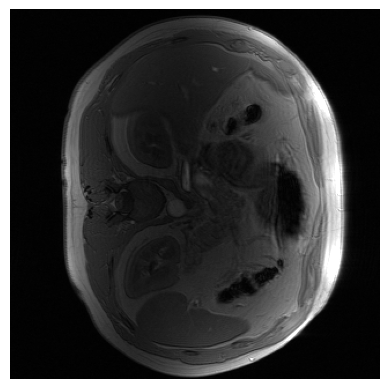

File: abdomen_GRE_V8_2D3ptDixon_m1.h5, Type: abdomen_dixon, Slice: 4


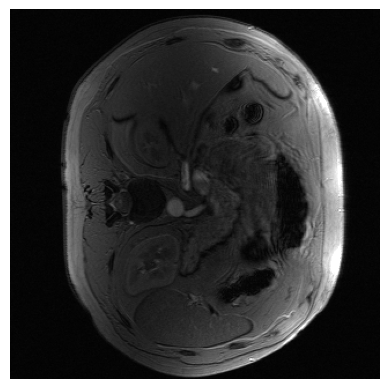

File: abdomen_GRE_V7_2D3ptDixon_m0.h5, Type: abdomen_dixon, Slice: 3


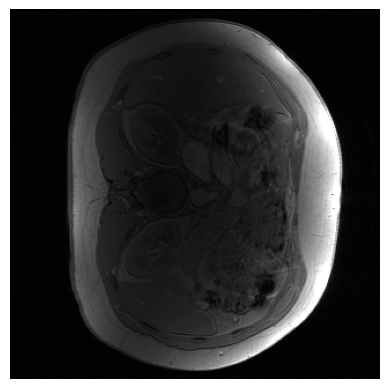

In [9]:
# SMURF: Total 45 slices
# 3 x knee conventional, 3 x knee watersat, 3 x knee fatsat, 4 x knee dixon 
# 3 x breast conventional, 3 x breast watersat, 3 x breast fatsat, 4 x breast dixon
# 3 x abdomen conventional, 3 x abdomen watersat, 3 x abdomen fatsat, 4 x abdomen dixon

subset = {}
subset['knee_conventional'] = [('knee_TSE_V1_conventional.h5', 21), ('knee_TSE_V2_conventional.h5', 15), ('knee_TSE_V3_conventional.h5', 28), ('knee_TSE_V1_conventional.h5', 9), ('knee_TSE_V3_conventional.h5', 3)]
subset['knee_watersat'] = [('knee_TSE_V1_waterSat.h5', 21), ('knee_TSE_V2_waterSat.h5', 15), ('knee_TSE_V3_waterSat.h5', 28), ('knee_TSE_V1_waterSat.h5', 9), ('knee_TSE_V3_waterSat.h5', 3)]
subset['knee_fatsat'] = [('knee_TSE_V1_fatSat.h5', 21), ('knee_TSE_V2_fatSat.h5', 15), ('knee_TSE_V3_fatSat.h5', 28), ('knee_TSE_V1_fatSat.h5', 9), ('knee_TSE_V3_fatSat.h5', 3)]
subset['knee_dixon'] = [('knee_TSE_V3_2ptDixon_m0.h5', 21), ('knee_TSE_V3_2ptDixon_m1.h5', 15), ('knee_TSE_V2_2ptDixon_m0.h5', 28), ('knee_TSE_V2_2ptDixon_m1.h5', 9), ('knee_TSE_V1_2ptDixon_m0.h5', 3)]


subset['breast_conventional'] = [('breasts_GRE_V4_conventional.h5', 1), ('breasts_GRE_V5_conventional.h5', 2), ('breasts_GRE_V6_conventional.h5', 3), ('breasts_GRE_V4_conventional.h5', 4), ('breasts_GRE_V6_conventional.h5', 0)]
subset['breast_watersat'] = [('breasts_GRE_V4_waterSat.h5', 2), ('breasts_GRE_V5_waterSat.h5', 3), ('breasts_GRE_V6_waterSat.h5', 1), ('breasts_GRE_V4_waterSat.h5', 3), ('breasts_GRE_V6_waterSat.h5', 3)]
subset['breast_fatsat'] = [('breasts_GRE_V4_fatSat.h5', 2), ('breasts_GRE_V5_fatSat.h5', 3), ('breasts_GRE_V6_fatSat.h5', 1), ('breasts_GRE_V4_fatSat.h5', 3), ('breasts_GRE_V6_fatSat.h5', 3)]
subset['breast_dixon'] = [('breasts_GRE_V6_2D3ptDixon_m0.h5', 1), ('breasts_GRE_V6_2D3ptDixon_m1.h5', 2), ('breasts_GRE_V5_2D3ptDixon_m0.h5', 3), ('breasts_GRE_V5_2D3ptDixon_m1.h5', 0), ('breasts_GRE_V4_2D3ptDixon_m0.h5',4)]

subset['abdomen_conventional'] = [('abdomen_GRE_V7_conventional.h5', 1), ('abdomen_GRE_V8_conventional.h5', 2), ('abdomen_GRE_V9_conventional.h5', 3), ('abdomen_GRE_V7_conventional.h5', 4), ('abdomen_GRE_V9_conventional.h5', 0)]
subset['abdomen_watersat'] = [('abdomen_GRE_V7_waterSat.h5', 3), ('abdomen_GRE_V8_waterSat.h5', 0), ('abdomen_GRE_V9_waterSat.h5', 1), ('abdomen_GRE_V7_waterSat.h5', 2), ('abdomen_GRE_V9_waterSat.h5', 3)]
subset['abdomen_fatsat'] = [('abdomen_GRE_V7_fatSat.h5', 3), ('abdomen_GRE_V8_fatSat.h5', 0), ('abdomen_GRE_V9_fatSat.h5', 1), ('abdomen_GRE_V7_fatSat.h5', 2), ('abdomen_GRE_V9_fatSat.h5', 3)]
subset['abdomen_dixon'] = [('abdomen_GRE_V9_2D3ptDixon_m0.h5', 1), ('abdomen_GRE_V9_2D3ptDixon_m1.h5', 2), ('abdomen_GRE_V8_2D3ptDixon_m0.h5', 0), ('abdomen_GRE_V8_2D3ptDixon_m1.h5', 4), ('abdomen_GRE_V7_2D3ptDixon_m0.h5', 3)]

path_to_json = 'datasets/evals/classic/smurf.json'
with open(path_to_json) as f:
    json_data = json.load(f)

# print('All files in eval dataset:', check_existence(subset, json_data))

plot_subset(subset, json_data)

# save_nuanced_subset(subset, json_data)

All files in eval dataset: True
File: val_P022_cine_sax_t=2.h5, Type: sax, Slice: 2


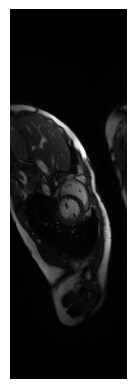

File: val_P025_cine_sax_t=8.h5, Type: sax, Slice: 8


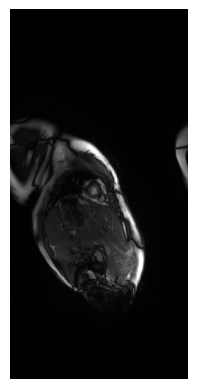

File: val_P042_cine_sax_t=1.h5, Type: sax, Slice: 1


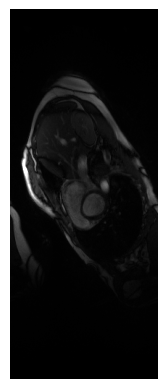

File: val_P007_cine_sax_t=3.h5, Type: sax, Slice: 4


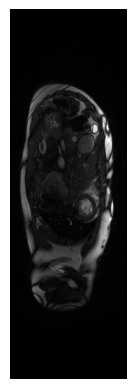

File: val_P027_cine_sax_t=8.h5, Type: sax, Slice: 2


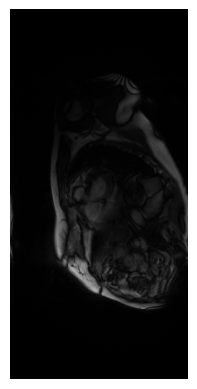

File: val_P017_cine_lax_t=6.h5, Type: lax, Slice: 1


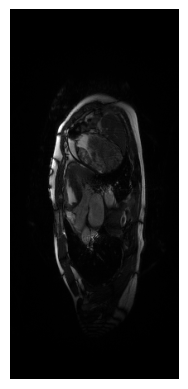

File: val_P022_cine_lax_t=2.h5, Type: lax, Slice: 0


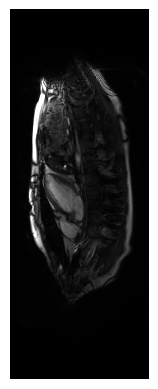

File: val_P044_cine_lax_t=6.h5, Type: lax, Slice: 1


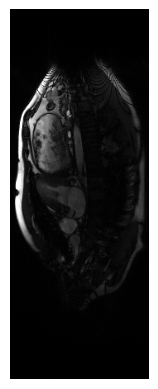

File: val_P016_cine_lax_t=9.h5, Type: lax, Slice: 2


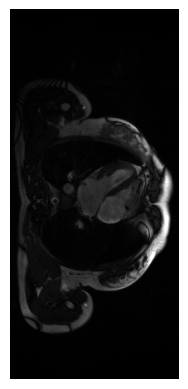

File: val_P007_cine_lax_t=4.h5, Type: lax, Slice: 0


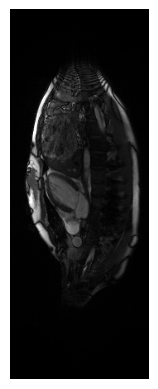

File: val_P003_T1map_t=5.h5, Type: t1, Slice: 4


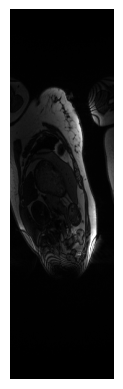

File: val_P050_T1map_t=1.h5, Type: t1, Slice: 0


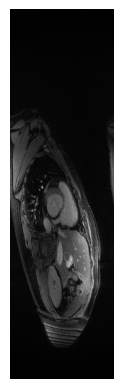

File: val_P023_T1map_t=0.h5, Type: t1, Slice: 0


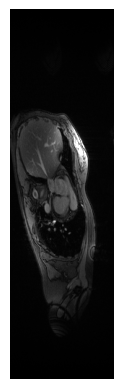

File: val_P048_T1map_t=7.h5, Type: t1, Slice: 5


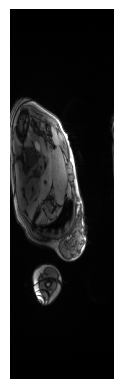

File: val_P013_T1map_t=4.h5, Type: t1, Slice: 4


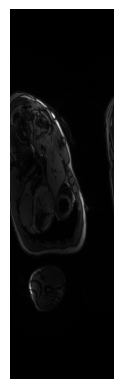

File: val_P014_T2map_t=0.h5, Type: t2, Slice: 4


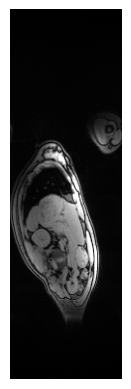

File: val_P012_T2map_t=0.h5, Type: t2, Slice: 2


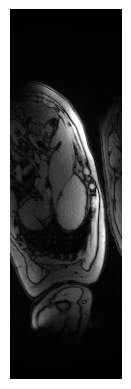

File: val_P043_T2map_t=1.h5, Type: t2, Slice: 4


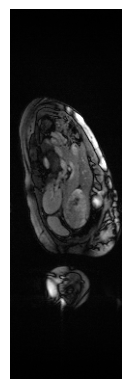

File: val_P014_T2map_t=1.h5, Type: t2, Slice: 1


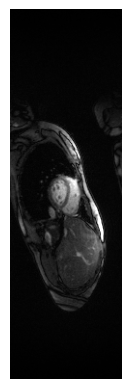

File: val_P011_T2map_t=1.h5, Type: t2, Slice: 2


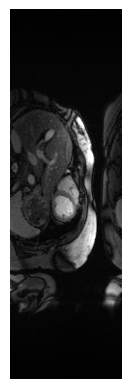

In [10]:
# CMRxRecon2023: Total 20 slices
# 5 x SAX, 5 x 2ch LAX, 5 x T1, 5 x T2

subset = {}
# SAX
subset['sax'] = ['val_P022_cine_sax_t=2.h5', 'val_P025_cine_sax_t=8.h5', 'val_P042_cine_sax_t=1.h5', 'val_P007_cine_sax_t=3.h5', 'val_P027_cine_sax_t=8.h5']
# LAX
subset['lax'] = ['val_P017_cine_lax_t=6.h5', 'val_P022_cine_lax_t=2.h5',  'val_P044_cine_lax_t=6.h5', 'val_P016_cine_lax_t=9.h5', 'val_P007_cine_lax_t=4.h5']
# T1
subset['t1'] = ['val_P003_T1map_t=5.h5', 'val_P050_T1map_t=1.h5', 'val_P023_T1map_t=0.h5', 'val_P048_T1map_t=7.h5', 'val_P013_T1map_t=4.h5']
# T2
subset['t2'] = ['val_P014_T2map_t=0.h5', 'val_P012_T2map_t=0.h5', 'val_P043_T2map_t=1.h5', 'val_P014_T2map_t=1.h5', 'val_P011_T2map_t=1.h5']

path_to_json = 'datasets/evals/classic/cmrxrecon2023.json'
with open(path_to_json) as f:
    json_data = json.load(f)

print('All files in eval dataset:', check_existence(subset, json_data))

random_slice(subset, json_data, low_percent=0.15, high_percent=0.85, seed=11)

plot_subset(subset, json_data)

# save_nuanced_subset(subset, json_data)

File: fs_0157_0_55T_t=14_m0.h5, Type: sax_055T, Slice: 0


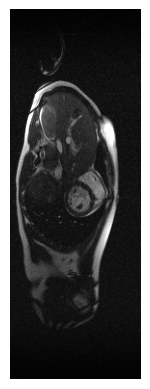

File: fs_0108_0_55T_t=1_m0.h5, Type: sax_055T, Slice: 0


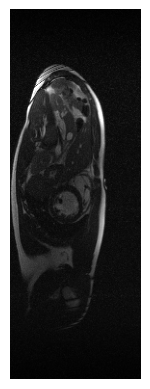

File: fs_0112_0_55T_t=3_m0.h5, Type: sax_055T, Slice: 0


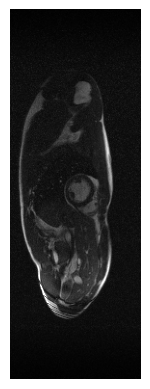

File: fs_0146_0_55T_t=8_m0.h5, Type: sax_055T, Slice: 0


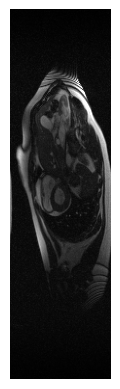

File: fs_0161_0_55T_t=12_m0.h5, Type: sax_055T, Slice: 0


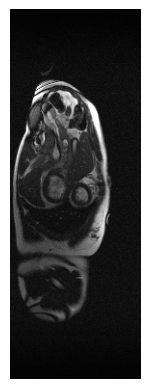

File: fs_0152_0_55T_t=3_m0.h5, Type: lax_055T, Slice: 0


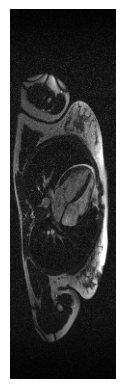

File: fs_0148_0_55T_t=2_m0.h5, Type: lax_055T, Slice: 0


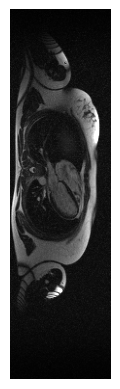

File: fs_0117_0_55T_t=10_m0.h5, Type: lax_055T, Slice: 0


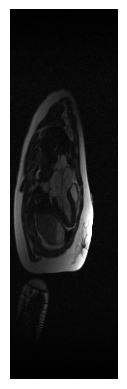

File: fs_0130_0_55T_t=15_m0.h5, Type: lax_055T, Slice: 0


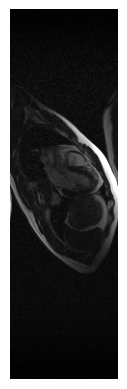

File: fs_0110_0_55T_t=8_m0.h5, Type: lax_055T, Slice: 0


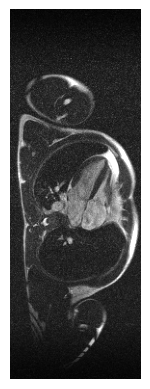

File: fs_0010_1_5T_t=14_m0.h5, Type: sax_15T, Slice: 0


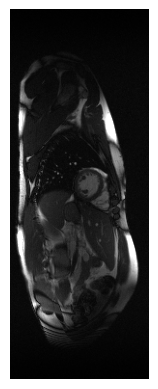

File: fs_0085_1_5T_t=16_m0.h5, Type: sax_15T, Slice: 0


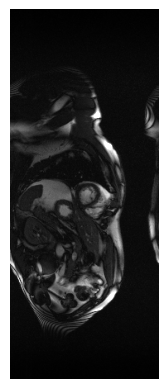

File: fs_0011_1_5T_t=7_m0.h5, Type: sax_15T, Slice: 0


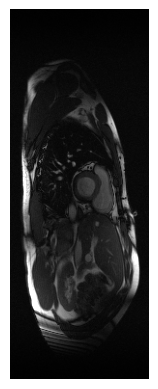

File: fs_0084_1_5T_t=10_m0.h5, Type: sax_15T, Slice: 0


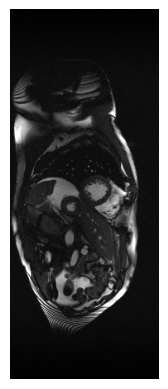

File: fs_0089_1_5T_t=3_m0.h5, Type: sax_15T, Slice: 0


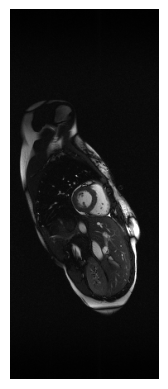

File: fs_0093_1_5T_t=12_m0.h5, Type: lax_15T, Slice: 0


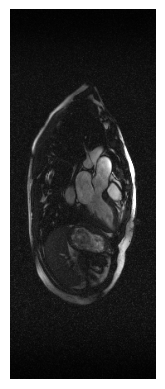

File: fs_0058_1_5T_t=8_m0.h5, Type: lax_15T, Slice: 0


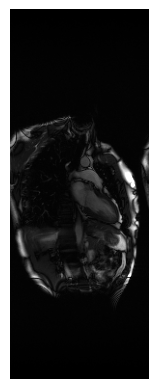

File: fs_0077_1_5T_t=10_m0.h5, Type: lax_15T, Slice: 0


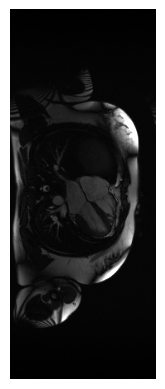

File: fs_0092_1_5T_t=4_m0.h5, Type: lax_15T, Slice: 0


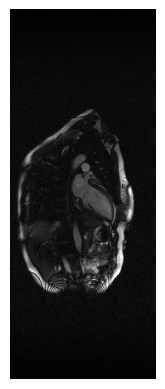

File: fs_0059_1_5T_t=6_m0.h5, Type: lax_15T, Slice: 0


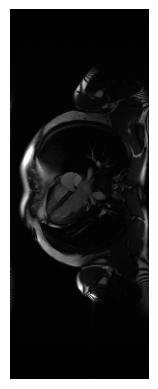

File: fs_0019_3T_t=3_m0.h5, Type: sax_30T, Slice: 0


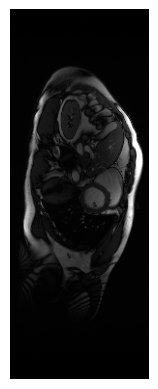

File: fs_0028_3T_t=15_m1.h5, Type: sax_30T, Slice: 0


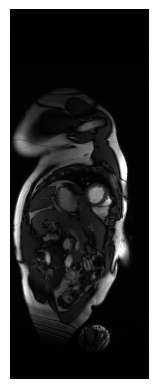

File: fs_0033_3T_t=5_m0.h5, Type: sax_30T, Slice: 0


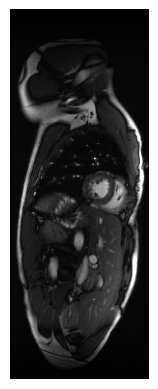

File: fs_0038_3T_t=8_m0.h5, Type: sax_30T, Slice: 0


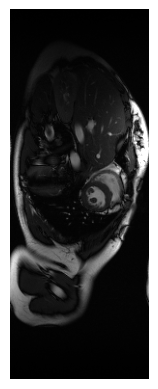

File: fs_0040_3T_t=10_m1.h5, Type: sax_30T, Slice: 0


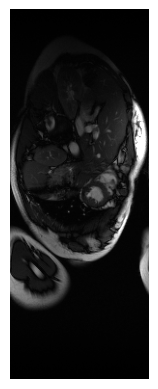

File: fs_0031_3T_t=6_m1.h5, Type: lax_30T, Slice: 0


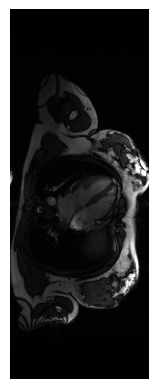

File: fs_0044_3T_t=13_m0.h5, Type: lax_30T, Slice: 0


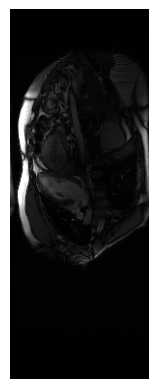

File: fs_0049_3T_t=3_m0.h5, Type: lax_30T, Slice: 0


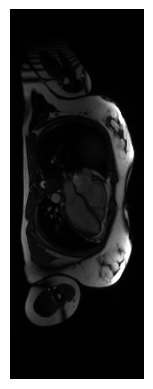

File: fs_0013_3T_t=8_m0.h5, Type: lax_30T, Slice: 0


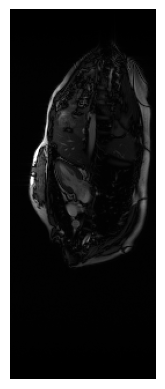

File: fs_0046_3T_t=2_m0.h5, Type: lax_30T, Slice: 0


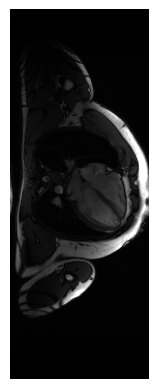

File: fs_0143_0_55T_t=16_m0.h5, Type: other_055T, Slice: 0


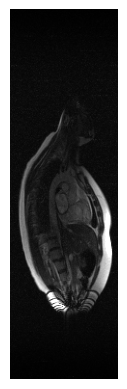

File: fs_0119_0_55T_t=10_m0.h5, Type: other_055T, Slice: 0


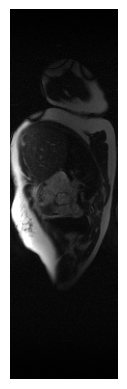

File: fs_0136_0_55T_t=8_m0.h5, Type: other_055T, Slice: 0


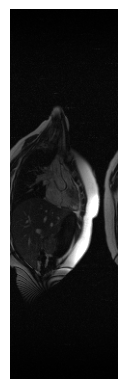

File: fs_0118_0_55T_t=14_m0.h5, Type: other_055T, Slice: 0


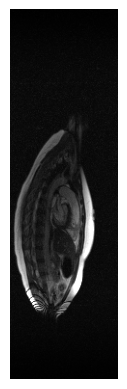

File: fs_0131_0_55T_t=12_m0.h5, Type: other_055T, Slice: 0


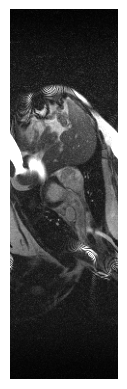

In [11]:
# OCMR: Total 35 slices
# 5 x SAX 0.55T, 5 x LAX 0.55T
# 5 x SAX 1.5T,  5 x LAX 1.5T
# 5 x SAX 3.0T,  5 x LAX 3.0T
# 5 x Other 0.55T

subset = {}
# SAX 0.55T
subset['sax_055T'] = ['fs_0157_0_55T_t=14_m0.h5', 'fs_0108_0_55T_t=1_m0.h5', 'fs_0112_0_55T_t=3_m0.h5', 'fs_0146_0_55T_t=8_m0.h5', 'fs_0161_0_55T_t=12_m0.h5']
# # LAX 0.55T
subset['lax_055T'] = ['fs_0152_0_55T_t=3_m0.h5', 'fs_0148_0_55T_t=2_m0.h5', 'fs_0117_0_55T_t=10_m0.h5', 'fs_0130_0_55T_t=15_m0.h5', 'fs_0110_0_55T_t=8_m0.h5']
# # SAX 1.5T
subset['sax_15T'] = ['fs_0010_1_5T_t=14_m0.h5', 'fs_0085_1_5T_t=16_m0.h5', 'fs_0011_1_5T_t=7_m0.h5', 'fs_0084_1_5T_t=10_m0.h5', 'fs_0089_1_5T_t=3_m0.h5']
# # LAX 1.5T
subset['lax_15T'] = ['fs_0093_1_5T_t=12_m0.h5', 'fs_0058_1_5T_t=8_m0.h5', 'fs_0077_1_5T_t=10_m0.h5',  'fs_0092_1_5T_t=4_m0.h5', 'fs_0059_1_5T_t=6_m0.h5']
# # SAX 3.0T
subset['sax_30T'] = ['fs_0019_3T_t=3_m0.h5', 'fs_0028_3T_t=15_m1.h5', 'fs_0033_3T_t=5_m0.h5', 'fs_0038_3T_t=8_m0.h5', 'fs_0040_3T_t=10_m1.h5']
# # LAX 3.0T
subset['lax_30T'] = ['fs_0031_3T_t=6_m1.h5', 'fs_0044_3T_t=13_m0.h5', 'fs_0049_3T_t=3_m0.h5',  'fs_0013_3T_t=8_m0.h5', 'fs_0046_3T_t=2_m0.h5']
# # Other 0.55T
subset['other_055T'] = ['fs_0143_0_55T_t=16_m0.h5', 'fs_0119_0_55T_t=10_m0.h5', 'fs_0136_0_55T_t=8_m0.h5', 'fs_0118_0_55T_t=14_m0.h5', 'fs_0131_0_55T_t=12_m0.h5']

path_to_json = 'datasets/evals/classic/ocmr.json'
with open(path_to_json) as f:
    json_data = json.load(f)

# print('All files in eval dataset:', check_existence(subset, json_data))

random_slice(subset, json_data, low_percent=0.15, high_percent=0.85, seed=7)

plot_subset(subset, json_data)

# save_nuanced_subset(subset, json_data)